In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import pandas.plotting
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
%matplotlib inline

In [2]:
file_loc = r'C:\Users\nkuma\Downloads\EE 798Q\Open pit blasting.csv'
air_pollution_data = pd.read_csv(file_loc, index_col=0,  header = 0)

In [3]:
air_pollution_data.head(1)

,From,To (Interval: 15M),"Singrauli, Surya Kiran Bhawan Dudhichua PM10 (µg/m3)","Singrauli, Surya Kiran Bhawan Dudhichua PM2.5 (µg/m3)","Singrauli, Surya Kiran Bhawan Dudhichua NO (µg/m3)","Singrauli, Surya Kiran Bhawan Dudhichua NO2 (µg/m3)","Singrauli, Surya Kiran Bhawan Dudhichua NOX (ppb)","Singrauli, Surya Kiran Bhawan Dudhichua CO (mg/m3)","Singrauli, Surya Kiran Bhawan Dudhichua SO2 (µg/m3)","Singrauli, Surya Kiran Bhawan Dudhichua NH3 (µg/m3)","Singrauli, Surya Kiran Bhawan Dudhichua Ozone (µg/m3)","Singrauli, Surya Kiran Bhawan Dudhichua Benzene (µg/m3)"
#,,,,,,,,,,,,
1,2023-02-01 00:00:00,2023-02-01 00:15:00,95.0,35.0,NaN,90.1,56.2,0.31,NaN,17.7,28.1,0.4


In [4]:
df = pd.DataFrame(air_pollution_data)

In [5]:
df.columns = ['From','To','PM10(µg/m3)','PM2.5(µg/m3)','NO(µg/m3)','NO2(µg/m3)','NOX(ppb)','CO(mg/m3)','SO2(µg/m3)','NH3(µg/m3)','Ozone(µg/m3)','Benzene(µg/m3)']

In [6]:
df.head(1)

,From,To,PM10(µg/m3),PM2.5(µg/m3),NO(µg/m3),NO2(µg/m3),NOX(ppb),CO(mg/m3),SO2(µg/m3),NH3(µg/m3),Ozone(µg/m3),Benzene(µg/m3)
#,,,,,,,,,,,,
1,2023-02-01 00:00:00,2023-02-01 00:15:00,95.0,35.0,NaN,90.1,56.2,0.31,NaN,17.7,28.1,0.4


In [7]:
df = df[:-3]
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8640 entries, 1 to 8640
Data columns (total 12 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   From            8640 non-null   object 
 1   To              8640 non-null   object 
 2   PM10(µg/m3)     6959 non-null   float64
 3   PM2.5(µg/m3)    8414 non-null   float64
 4   NO(µg/m3)       7271 non-null   float64
 5   NO2(µg/m3)      8224 non-null   float64
 6   NOX(ppb)        8225 non-null   float64
 7   CO(mg/m3)       8144 non-null   float64
 8   SO2(µg/m3)      7189 non-null   float64
 9   NH3(µg/m3)      8314 non-null   float64
 10  Ozone(µg/m3)    8187 non-null   float64
 11  Benzene(µg/m3)  2445 non-null   float64
dtypes: float64(10), object(2)
memory usage: 877.5+ KB


In [8]:
df['To'] = pd.to_datetime(df['To'],format='%Y-%m-%d %H:%M:%S')

In [9]:
df['To'].head()

#
1   2023-02-01 00:15:00
2   2023-02-01 00:30:00
3   2023-02-01 00:45:00
4   2023-02-01 01:00:00
5   2023-02-01 01:15:00
Name: To, dtype: datetime64[ns]

In [10]:
df.drop(['From'], axis = 1, inplace = True)

In [11]:
df.set_index('To', inplace = True)

In [12]:
df.isnull().sum()

PM10(µg/m3)       1681
PM2.5(µg/m3)       226
NO(µg/m3)         1369
NO2(µg/m3)         416
NOX(ppb)           415
CO(mg/m3)          496
SO2(µg/m3)        1451
NH3(µg/m3)         326
Ozone(µg/m3)       453
Benzene(µg/m3)    6195
dtype: int64

In [13]:
PM10 = df['PM10(µg/m3)']
PM25 = df['PM2.5(µg/m3)']
NO = df['NO(µg/m3)']
NO2 = df['NO2(µg/m3)']
NOX = df['NOX(ppb)']
CO = df['CO(mg/m3)']
SO2 = df['SO2(µg/m3)']
NH3 = df['NH3(µg/m3)']
OZONE = df['Ozone(µg/m3)']
BENZENE = df['Benzene(µg/m3)']

In [65]:
df[PM10.isnull()]

,PM10(µg/m3),PM2.5(µg/m3),NO(µg/m3),NO2(µg/m3),NOX(ppb),CO(mg/m3),SO2(µg/m3),NH3(µg/m3),Ozone(µg/m3),Benzene(µg/m3)
To,,,,,,,,,,
2023-02-04 13:15:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-02-04 13:30:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-02-04 13:45:00,NaN,NaN,NaN,55.2,34.4,NaN,NaN,28.5,NaN,NaN
2023-02-04 14:00:00,NaN,NaN,NaN,54.7,35.6,1.34,NaN,30.0,65.1,NaN
2023-02-04 14:15:00,NaN,NaN,NaN,56.4,36.8,1.33,NaN,29.5,63.5,NaN
...,...,...,...,...,...,...,...,...,...,...
2023-04-13 18:15:00,NaN,52.0,1.2,38.2,21.3,1.02,18.5,13.7,64.7,NaN
2023-04-13 18:30:00,NaN,52.0,1.7,40.8,23.1,0.97,17.3,14.3,64.3,NaN
2023-04-13 18:45:00,NaN,52.0,1.8,43.3,24.5,0.94,17.6,15.0,62.6,NaN


# Check for seasonality in PM10

In [40]:
import plotly.express as px
fig = px.line(df, x=df.index, y='PM10(µg/m3)', title='emission of PM10 in (µg/m3)')
fig.update_xaxes(
    rangeslider_visible = True,
    rangeselector = dict(
        buttons = list([
            dict(count = 1, label = "1m", step="month", stepmode="backward"),
            dict(count = 2, label = "2m", step="month", stepmode="backward"),
            dict(count = 3, label = "3m", step="month", stepmode="backward"),
            dict(step="all")
        ])))
fig.show()

As we can see there are some missing values in the data so the graph is broken in pieces we can zoom in to a particular time and see the density of PM10 during that time

Also we can see there is no seasonality in the density of PM10 over these three months because we can see significant peaks in its density which is variying across the day over these months

In [66]:
df_copy = df.copy()
df_copy = df_copy.dropna()
df_copy

,PM10(µg/m3),PM2.5(µg/m3),NO(µg/m3),NO2(µg/m3),NOX(ppb),CO(mg/m3),SO2(µg/m3),NH3(µg/m3),Ozone(µg/m3),Benzene(µg/m3)
To,,,,,,,,,,
2023-02-11 11:15:00,110.0,26.0,18.1,74.9,54.5,0.38,8.2,32.0,59.5,0.3
2023-02-11 11:30:00,110.0,26.0,14.4,73.1,50.6,0.35,8.2,32.0,56.7,0.2
2023-02-11 11:45:00,110.0,26.0,11.5,72.4,47.8,0.29,7.9,31.8,52.0,0.2
2023-02-11 12:45:00,110.0,20.0,9.9,65.2,42.8,0.30,7.5,22.8,52.4,0.2
2023-02-11 13:00:00,90.0,13.0,9.8,67.8,44.0,0.30,7.8,22.9,54.5,0.2
...,...,...,...,...,...,...,...,...,...,...
2023-05-01 22:45:00,28.0,7.0,17.1,99.0,66.6,0.72,9.5,10.9,17.2,0.1
2023-05-01 23:00:00,19.0,11.0,17.9,100.0,67.8,0.63,10.0,10.7,26.1,0.1
2023-05-01 23:15:00,19.0,11.0,17.9,100.0,67.7,0.57,10.0,10.4,30.9,0.1


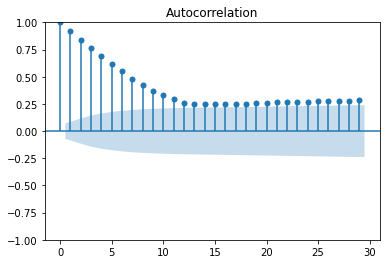

In [42]:
acf_plot = plot_acf(df_copy['PM10(µg/m3)'])

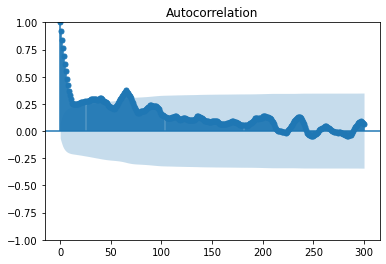

In [18]:
acf_plot = plot_acf(df_copy['PM10(µg/m3)'], lags = 300)

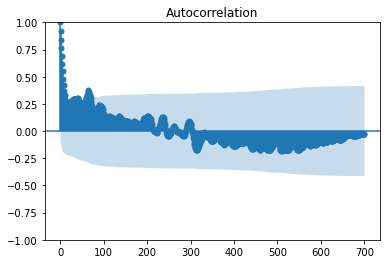

In [19]:
acf_plot = plot_acf(df_copy['PM10(µg/m3)'], lags = 700)

<AxesSubplot:xlabel='y(t)', ylabel='y(t + 1)'>

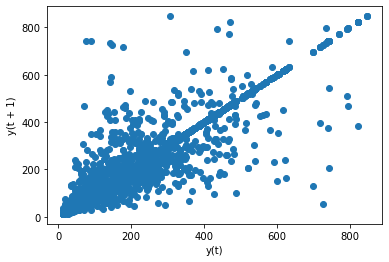

In [20]:
pd.plotting.lag_plot(df['PM10(µg/m3)'], lag = 1)

By plotting autocorrelation plot of PM10 and lag plot with varying lags also suggests that there is no seasonality in its density

Hence there is no seasonality in PM10 we cannot replace its nan values with its past month values

# Check for seasonality in O3

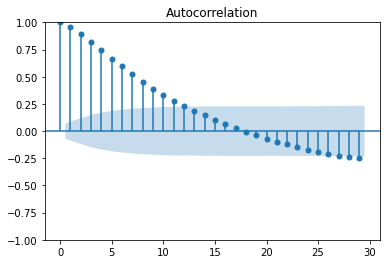

In [21]:
acf_plot = plot_acf(df_copy['Ozone(µg/m3)'])

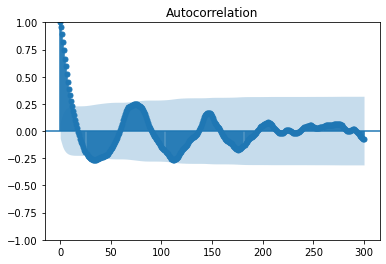

In [22]:
acf_plot = plot_acf(df_copy['Ozone(µg/m3)'], lags = 300)

Now there is some amount of seasonality in density of Ozone

<AxesSubplot:xlabel='Lag', ylabel='Autocorrelation'>

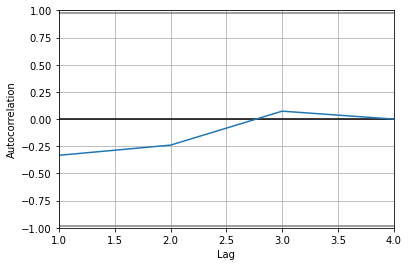

In [23]:
pd.plotting.autocorrelation_plot(df_copy[:]['Ozone(µg/m3)'].resample("1m").mean())

In [43]:
import plotly.express as px
fig = px.line(df, x=df.index, y='Ozone(µg/m3)', title='emission of Ozone in (µg/m3)')
fig.update_xaxes(
    rangeslider_visible = True,
    rangeselector = dict(
        buttons = list([
            dict(count = 1, label = "1m", step="month", stepmode="backward"),
            dict(count = 2, label = "2m", step="month", stepmode="backward"),
            dict(count = 3, label = "3m", step="month", stepmode="backward"),
            dict(step="all")
        ])))
fig.show()

From the above graph we can see that ozone values get a peak during 13:00-14:00 hrs in the day. So by using seasonality we can interpolate missing Ozone data by its last day data during that same time

Ozone (O3) is not typically released directly as a byproduct of open pit mining operations. Ozone is a naturally occurring gas found in the Earth's atmosphere, primarily in the ozone layer. However, certain mining activities can indirectly contribute to the formation of ozone through the release of precursor pollutants, such as nitrogen oxides (NOx) and volatile organic compounds (VOCs).

Hence we can vouch for seasonality occuring in ozone density over time and interpolate it through seasonality by replacing its missing data with previous day's same time data

In [25]:
# df['Ozone(µg/m3) after interpolation'] = df['Ozone(µg/m3)'].fillna(method='ffill')
# df['Ozone(µg/m3) after interpolation'].info()

In [16]:
df_shifted = df.shift(freq='-15min')
df_shifted

,PM10(µg/m3),PM2.5(µg/m3),NO(µg/m3),NO2(µg/m3),NOX(ppb),CO(µg/m3),SO2(µg/m3),NH3(µg/m3),Ozone(µg/m3),Benzene(µg/m3)
To,,,,,,,,,,
2023-02-01 00:00:00,95.0,35.0,NaN,90.1,56.2,0.31,NaN,17.7,28.1,0.4
2023-02-01 00:15:00,95.0,35.0,NaN,88.0,55.1,0.33,NaN,18.3,27.1,0.4
2023-02-01 00:30:00,95.0,35.0,NaN,87.7,55.2,0.38,NaN,19.7,24.9,0.4
2023-02-01 00:45:00,122.0,34.0,NaN,88.9,55.7,0.38,NaN,21.3,21.9,0.4
2023-02-01 01:00:00,122.0,34.0,NaN,90.0,55.8,0.38,NaN,22.3,16.7,0.4
...,...,...,...,...,...,...,...,...,...,...
2023-05-01 22:45:00,19.0,11.0,17.9,100.0,67.8,0.63,10.0,10.7,26.1,0.1
2023-05-01 23:00:00,19.0,11.0,17.9,100.0,67.7,0.57,10.0,10.4,30.9,0.1
2023-05-01 23:15:00,19.0,11.0,19.6,100.2,69.2,0.58,9.9,10.5,29.6,0.1


In [17]:
df_filled = df['Ozone(µg/m3)'].fillna(method='ffill')

In [18]:
df_filled.update(df_shifted['Ozone(µg/m3)'])

In [19]:
df_filled.isnull().sum()

0

In [20]:
df_filled = df_filled.shift(freq='15min')

<IPython.core.display.Javascript object>


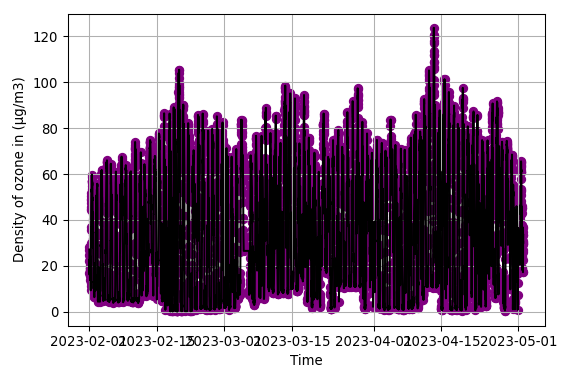

In [21]:
%matplotlib notebook
plt.scatter(df.index, df['Ozone(µg/m3)'], label = 'Given density of ozone' , color = 'purple')
plt.plot(df_filled, label = 'Density of ozone after interpolation', color = 'black')
plt.xlabel('Time')
plt.ylabel('Density of ozone in (µg/m3)')
plt.grid()
plt.tight_layout()
plt.show()

In [22]:
df_filled

To
2023-02-01 00:30:00    27.1
2023-02-01 00:45:00    24.9
2023-02-01 01:00:00    21.9
2023-02-01 01:15:00    16.7
2023-02-01 01:30:00    16.1
                       ... 
2023-05-01 23:15:00    30.9
2023-05-01 23:30:00    29.6
2023-05-01 23:45:00    30.0
2023-05-02 00:00:00    33.5
2023-05-02 00:15:00    33.5
Name: Ozone(µg/m3), Length: 8640, dtype: float64

# Checking seasonality for other pollutants

<IPython.core.display.Javascript object>


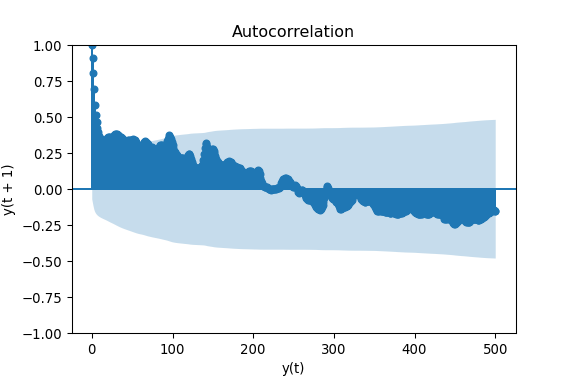

In [33]:
acf_plot = plot_acf(df_copy['PM2.5(µg/m3)'], lags = 500)

In [34]:
pd.plotting.lag_plot(df['PM2.5(µg/m3)'], lag = 1)

<AxesSubplot:title={'center':'Autocorrelation'}, xlabel='y(t)', ylabel='y(t + 1)'>

In [35]:
#No seasonality for PM2.5

<IPython.core.display.Javascript object>


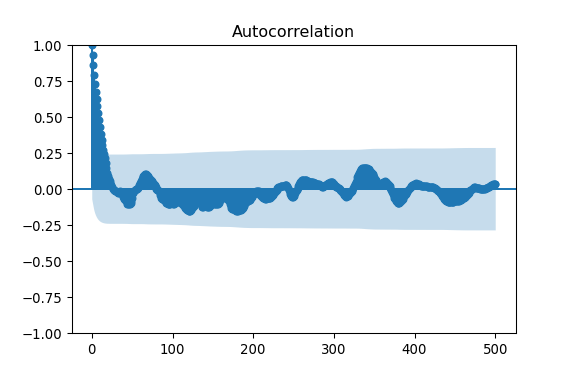

In [36]:
acf_plot = plot_acf(df_copy['NO(µg/m3)'], lags = 500)

In [37]:
#No seasonality in No

<IPython.core.display.Javascript object>


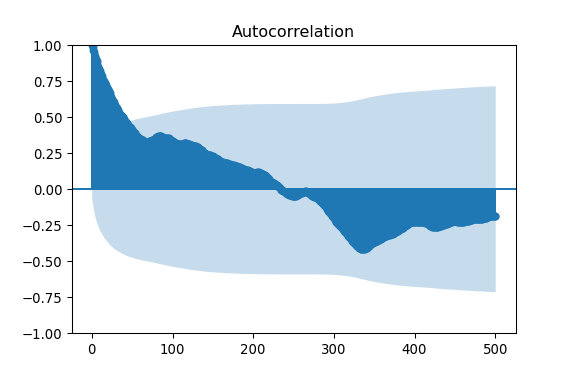

In [38]:
acf_plot = plot_acf(df_copy['NO2(µg/m3)'], lags = 500)

In [39]:
#No seasonality in NO2

<IPython.core.display.Javascript object>


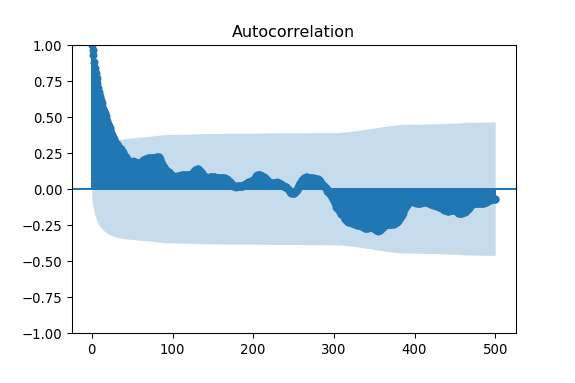

In [40]:
acf_plot = plot_acf(df_copy['NOX(ppb)'], lags = 500)

In [41]:
#No seasonality in NOX

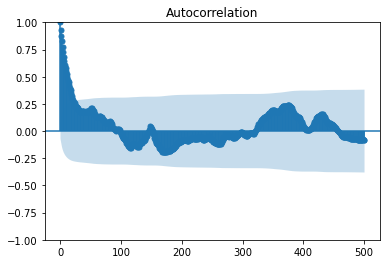

In [44]:
acf_plot = plot_acf(df_copy['CO(mg/m3)'], lags = 500)

In [43]:
#No seasonality in CO

<IPython.core.display.Javascript object>


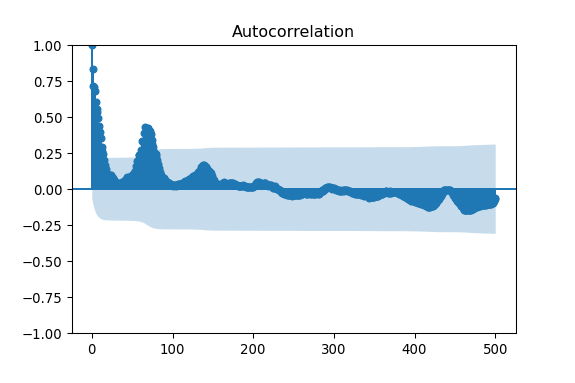

In [44]:
acf_plot = plot_acf(df_copy['SO2(µg/m3)'], lags = 500)

In [45]:
#Some amount of seasonality in SO2

<IPython.core.display.Javascript object>


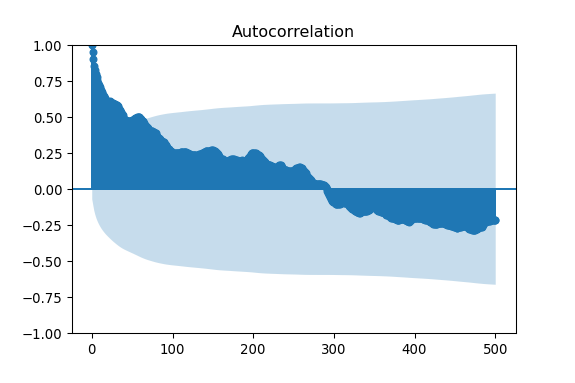

In [46]:
acf_plot = plot_acf(df_copy['NH3(µg/m3)'], lags = 500)

In [47]:
#No seasonality in NH3

<IPython.core.display.Javascript object>


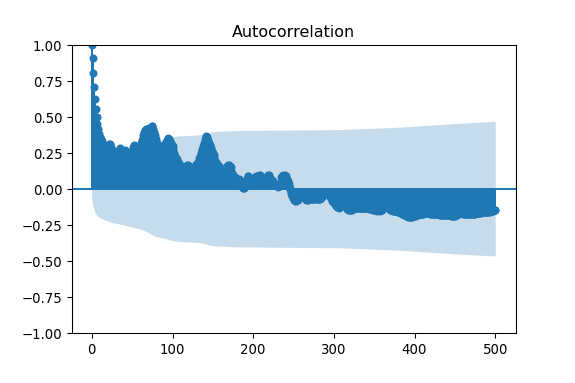

In [48]:
acf_plot = plot_acf(df_copy['Benzene(µg/m3)'], lags = 500)

In [49]:
#Little amount of seasonality is present in benzene

# Doing linear, cubic and spline interpolation for remaining columns

In [14]:
df_hash = df.copy()

In [15]:
df_linear = df_hash.interpolate(method = 'linear')
df_linear.fillna(method = 'ffill', inplace = True)
df_linear.fillna(method = 'bfill', inplace = True)

In [16]:
df_cubic = df_hash.interpolate(method = 'cubic')
df_cubic.fillna(method = 'ffill', inplace = True)
df_cubic.fillna(method = 'bfill', inplace = True)

In [17]:
df_spline = df_hash.interpolate(method = 'spline', order=3)
df_spline.fillna(method = 'ffill', inplace = True)
df_spline.fillna(method = 'bfill', inplace = True)

# Interpolation for PM10

<IPython.core.display.Javascript object>


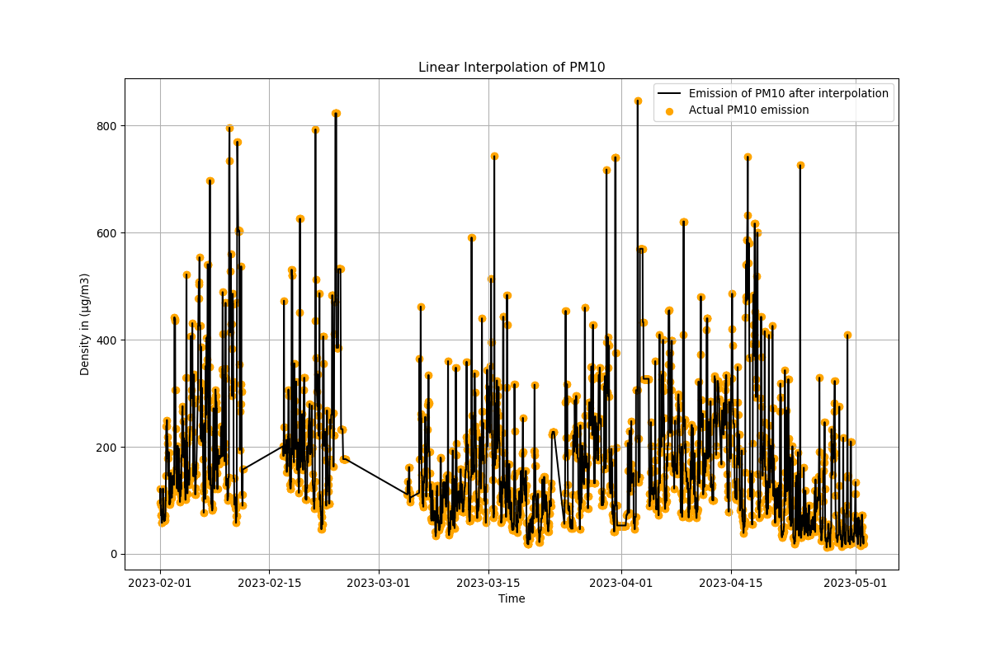

In [55]:
%matplotlib notebook
plt.plot(df_hash.index, df_linear['PM10(µg/m3)'], label = 'Emission of PM10 after interpolation', color = 'black')
plt.scatter(df.index, PM10, label = 'Actual PM10 emission' ,  color = 'orange')
plt.title('Linear Interpolation of PM10')
plt.xlabel('Time')
plt.ylabel('Density in (µg/m3)')
plt.grid()
plt.legend()
plt.show()

Cubic Interpolation for PM10

<IPython.core.display.Javascript object>


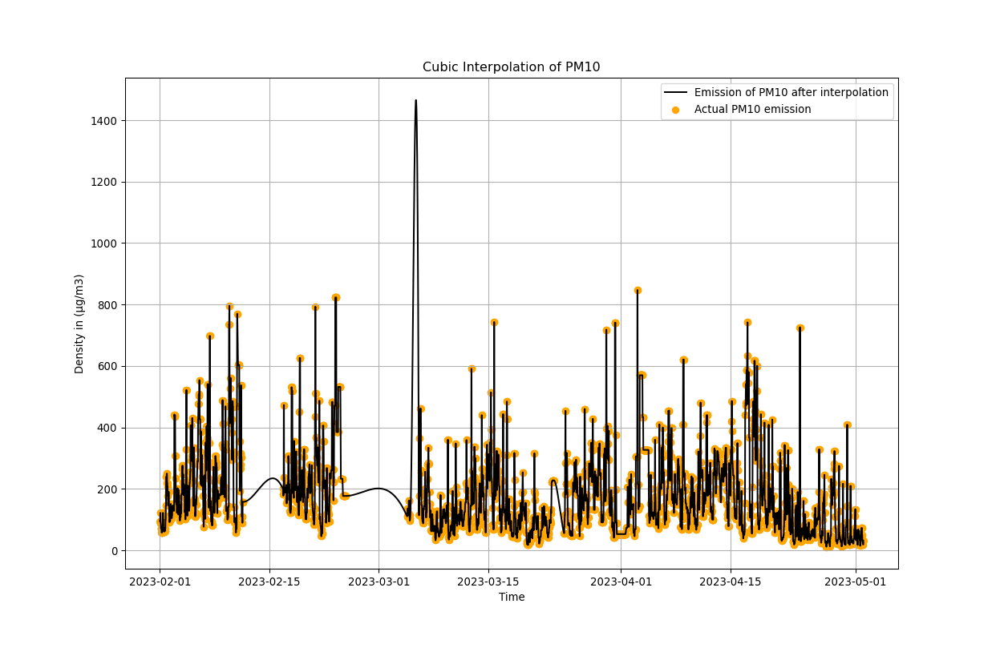

In [56]:
%matplotlib notebook
plt.plot(df_hash.index, df_cubic['PM10(µg/m3)'], label = 'Emission of PM10 after interpolation', color = 'black')
plt.scatter(df.index, PM10, label = 'Actual PM10 emission' ,  color = 'orange')
plt.title('Cubic Interpolation of PM10')
plt.xlabel('Time')
plt.ylabel('Density in (µg/m3)')
plt.grid()
plt.legend()
plt.show()

Spline interpolation for PM10

<IPython.core.display.Javascript object>


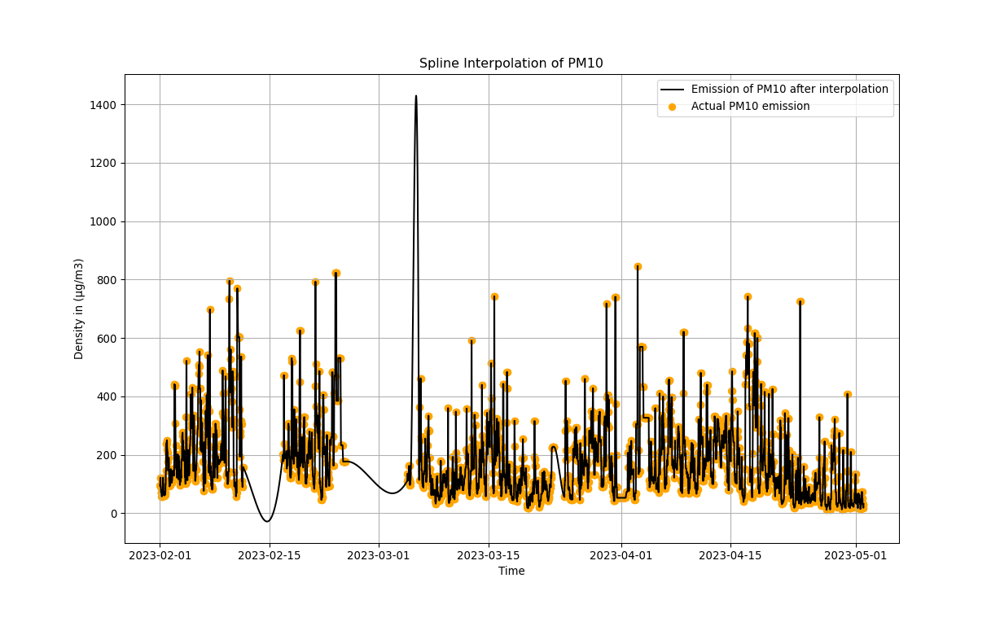

In [57]:
%matplotlib notebook
plt.plot(df.index, df_spline['PM10(µg/m3)'], label = 'Emission of PM10 after interpolation', color = 'black')
plt.scatter(df.index, PM10, label = 'Actual PM10 emission' ,  color = 'orange')
plt.title('Spline Interpolation of PM10')
plt.xlabel('Time')
plt.ylabel('Density in (µg/m3)')
plt.grid()
plt.legend()
plt.show()

Comparing Linear, Cubic and Spline Interpolation together with Actual data

<IPython.core.display.Javascript object>


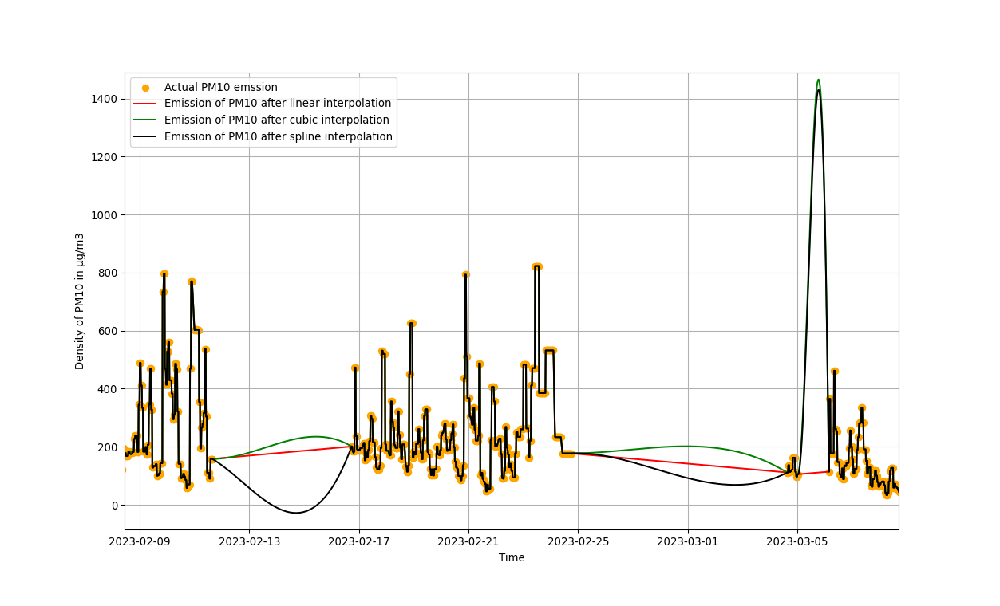

In [58]:
%matplotlib notebook
plt.scatter(df.index, PM10, label='Actual PM10 emssion', color='orange')
plt.plot(df.index, df_linear['PM10(µg/m3)'], label = 'Emission of PM10 after linear interpolation', color = 'red')
plt.plot(df.index, df_cubic['PM10(µg/m3)'], label = 'Emission of PM10 after cubic interpolation', color = 'green')
plt.plot(df.index, df_spline['PM10(µg/m3)'], label = 'Emission of PM10 after spline interpolation', color = 'black')
plt.xlabel('Time')
plt.ylabel('Density of PM10 in µg/m3')
plt.grid()
plt.legend()
plt.show()

Clearly cubic and spline interpolation gave some absuredly high as well as low values of PM10 as compared to linear interpolation. Hence we conclude that linear interpolation is best for PM10

# Interpolation for PM2.5

Linear Interpolation for PM2.5

<IPython.core.display.Javascript object>


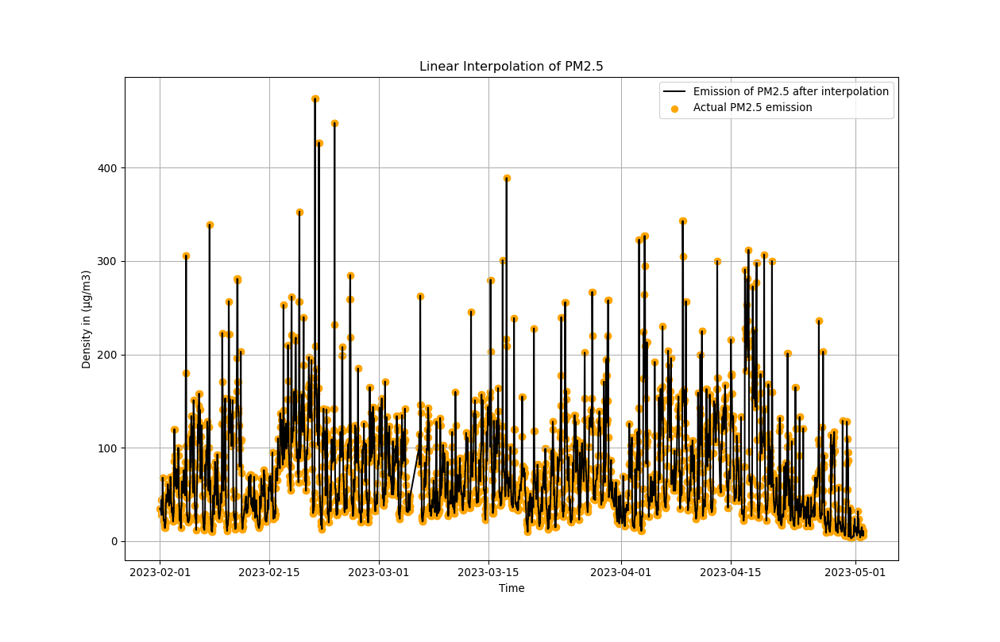

In [99]:
%matplotlib notebook
plt.plot(df.index, df_linear['PM2.5(µg/m3)'], label = 'Emission of PM2.5 after interpolation', color = 'black')
plt.scatter(df.index, PM25, label = 'Actual PM2.5 emission' ,  color = 'orange')
plt.title('Linear Interpolation of PM2.5')
plt.xlabel('Time')
plt.ylabel('Density in (µg/m3)')
plt.grid()
plt.legend()
plt.show()

Cubic Interpolation for PM2.5

<IPython.core.display.Javascript object>


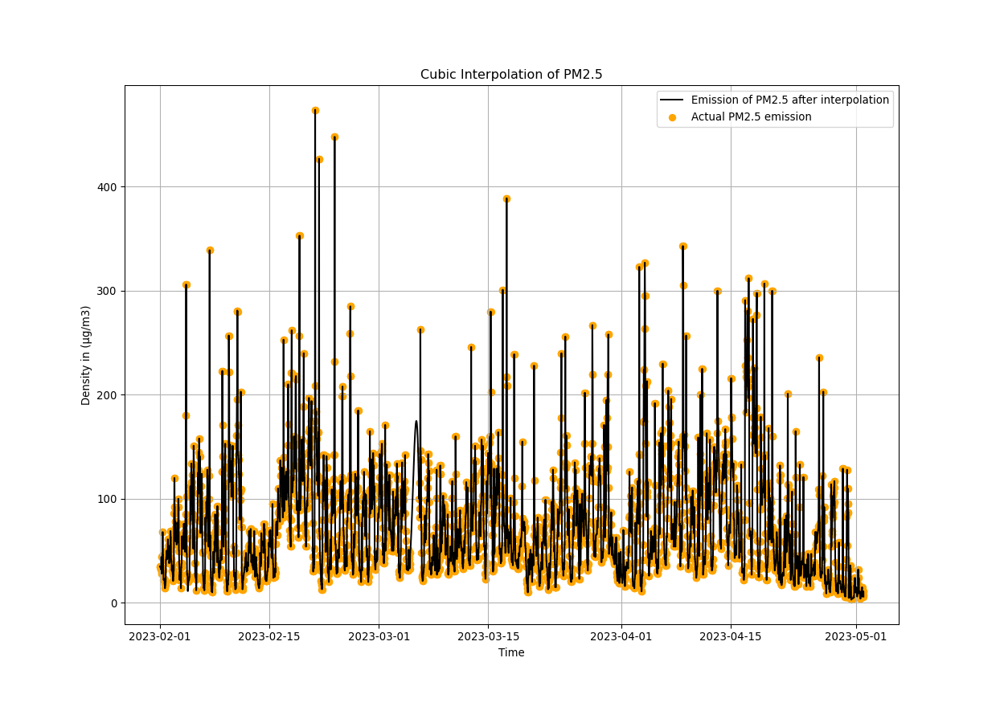

In [100]:
%matplotlib notebook
plt.plot(df.index, df_cubic['PM2.5(µg/m3)'], label = 'Emission of PM2.5 after interpolation', color = 'black')
plt.scatter(df.index, PM25, label = 'Actual PM2.5 emission' ,  color = 'orange')
plt.title('Cubic Interpolation of PM2.5')
plt.xlabel('Time')
plt.ylabel('Density in (µg/m3)')
plt.grid()
plt.legend()
plt.show()

Spline Interpolation for PM2.5

<IPython.core.display.Javascript object>


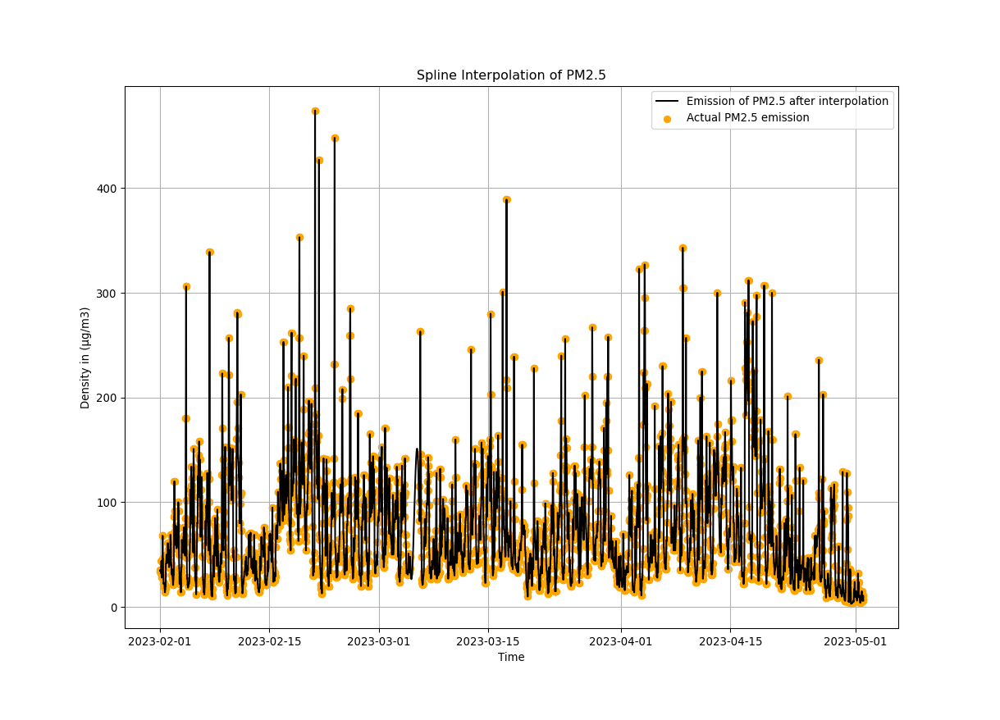

In [101]:
%matplotlib notebook
plt.plot(df.index, df_spline['PM2.5(µg/m3)'], label = 'Emission of PM2.5 after interpolation', color = 'black')
plt.scatter(df.index, PM25, label = 'Actual PM2.5 emission' ,  color = 'orange')
plt.title('Spline Interpolation of PM2.5')
plt.xlabel('Time')
plt.ylabel('Density in (µg/m3)')
plt.grid()
plt.legend()
plt.show()

Comparing Linear, Cubic and Spline Interpolation together with Actual data

<IPython.core.display.Javascript object>


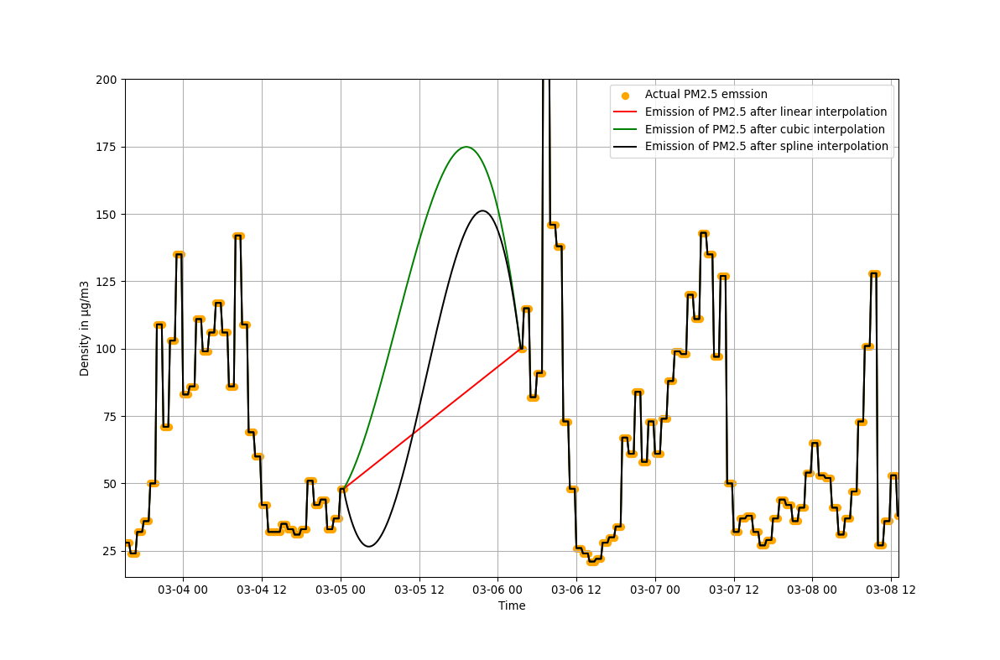

In [102]:
%matplotlib notebook
plt.scatter(df.index, PM25, label='Actual PM2.5 emssion', color='orange')
plt.plot(df.index, df_linear['PM2.5(µg/m3)'], label = 'Emission of PM2.5 after linear interpolation', color = 'red')
plt.plot(df.index, df_cubic['PM2.5(µg/m3)'], label = 'Emission of PM2.5 after cubic interpolation', color = 'green')
plt.plot(df.index, df_spline['PM2.5(µg/m3)'], label = 'Emission of PM2.5 after spline interpolation', color = 'black')
plt.xlabel('Time')
plt.ylabel('Density in µg/m3')
plt.grid()
plt.legend()
plt.show()

Above graph represents that cubic or spline interpolation fits best for PM2.5 as compared to linearas linear interpolation just joins the data points but cubic and spline give almost similar results which may also get by different ways to fill nan values example backward fill

# Interpolation for NO

Linear Interpolation for NO

<IPython.core.display.Javascript object>


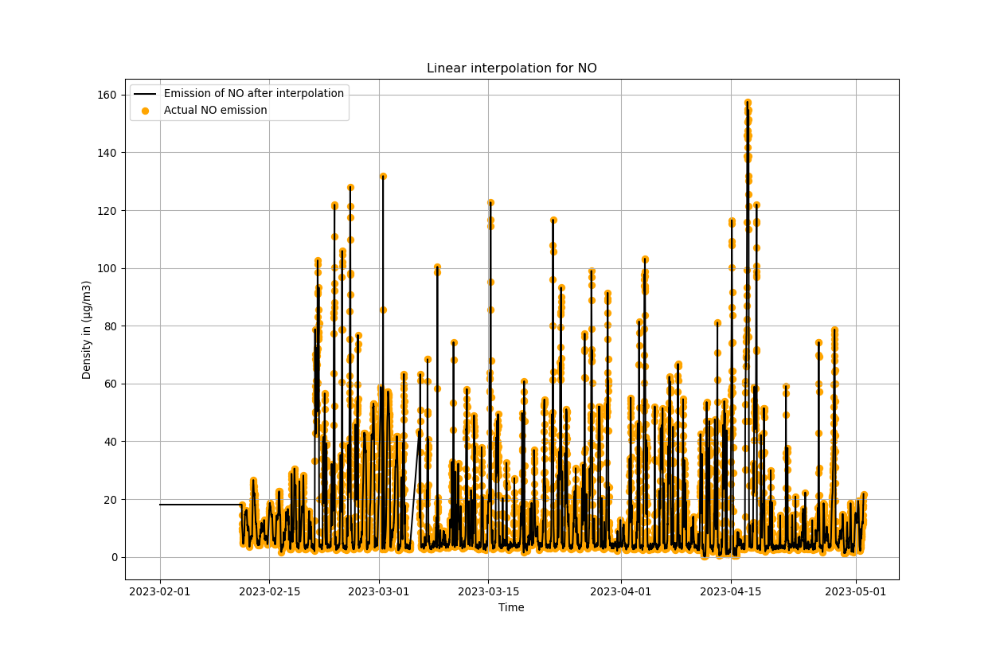

In [103]:
%matplotlib notebook
plt.plot(df.index, df_linear['NO(µg/m3)'], label = 'Emission of NO after interpolation', color = 'black')
plt.scatter(df.index, NO, label = 'Actual NO emission' ,  color = 'orange')
plt.title('Linear interpolation for NO')
plt.xlabel('Time')
plt.ylabel('Density in (µg/m3)')
plt.grid()
plt.legend()
plt.show()

Cubic Interpolation for NO

<IPython.core.display.Javascript object>


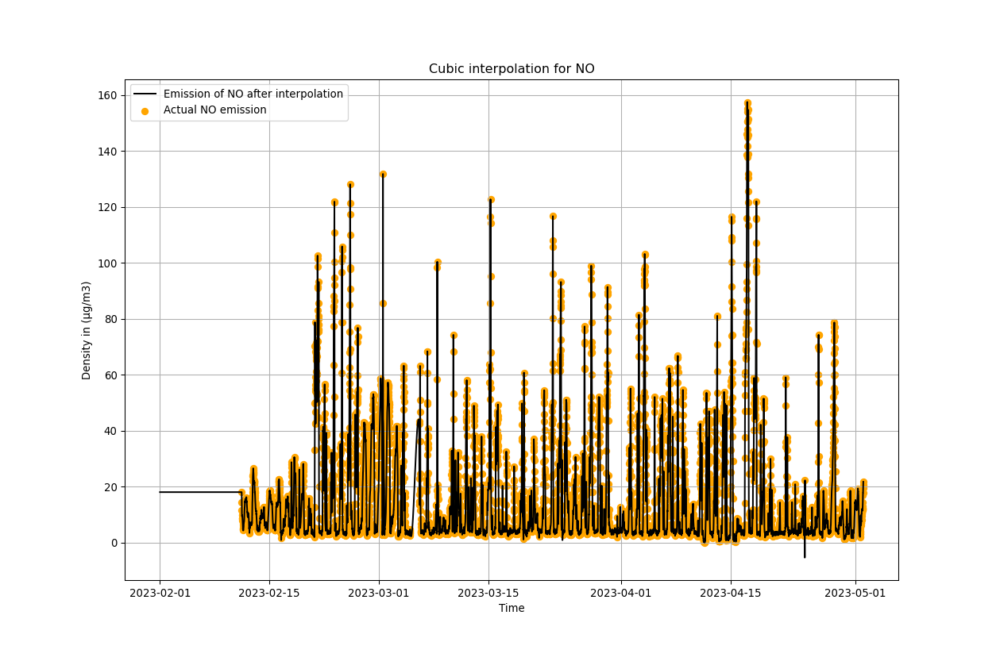

In [104]:
%matplotlib notebook
plt.plot(df.index, df_cubic['NO(µg/m3)'], label = 'Emission of NO after interpolation', color = 'black')
plt.scatter(df.index, NO, label = 'Actual NO emission' ,  color = 'orange')
plt.title('Cubic interpolation for NO')
plt.xlabel('Time')
plt.ylabel('Density in (µg/m3)')
plt.grid()
plt.legend()
plt.show()

Spline interpolation for NO

<IPython.core.display.Javascript object>


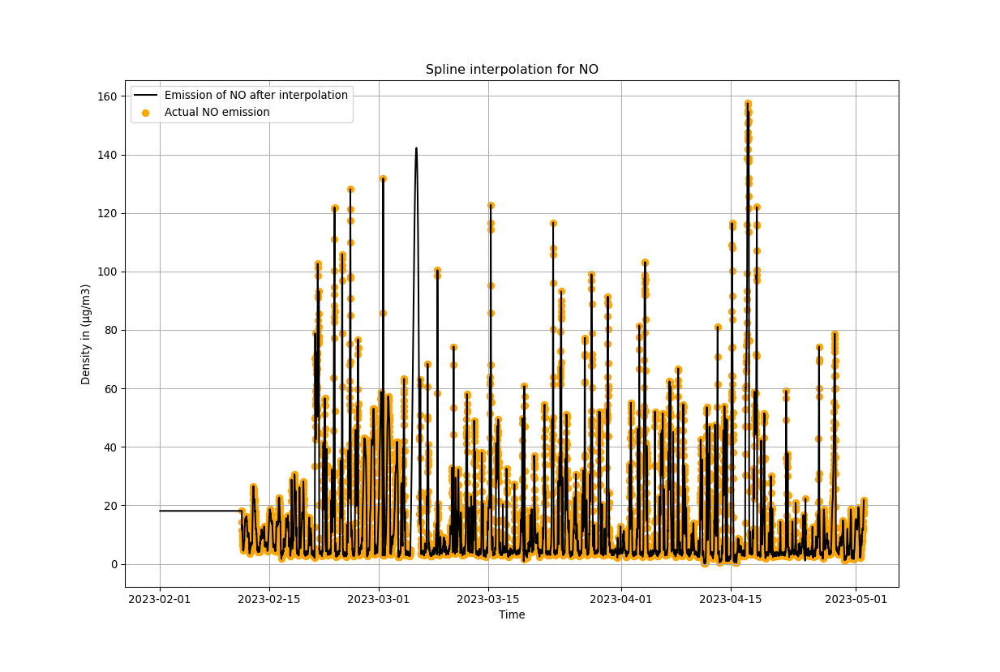

In [105]:
%matplotlib notebook
plt.plot(df.index, df_spline['NO(µg/m3)'], label = 'Emission of NO after interpolation', color = 'black')
plt.scatter(df.index, NO, label = 'Actual NO emission' ,  color = 'orange')
plt.title('Spline interpolation for NO')
plt.xlabel('Time')
plt.ylabel('Density in (µg/m3)')
plt.grid()
plt.legend()
plt.show()

Comparing linear, cubic and spline interpolation together with actual data

<IPython.core.display.Javascript object>


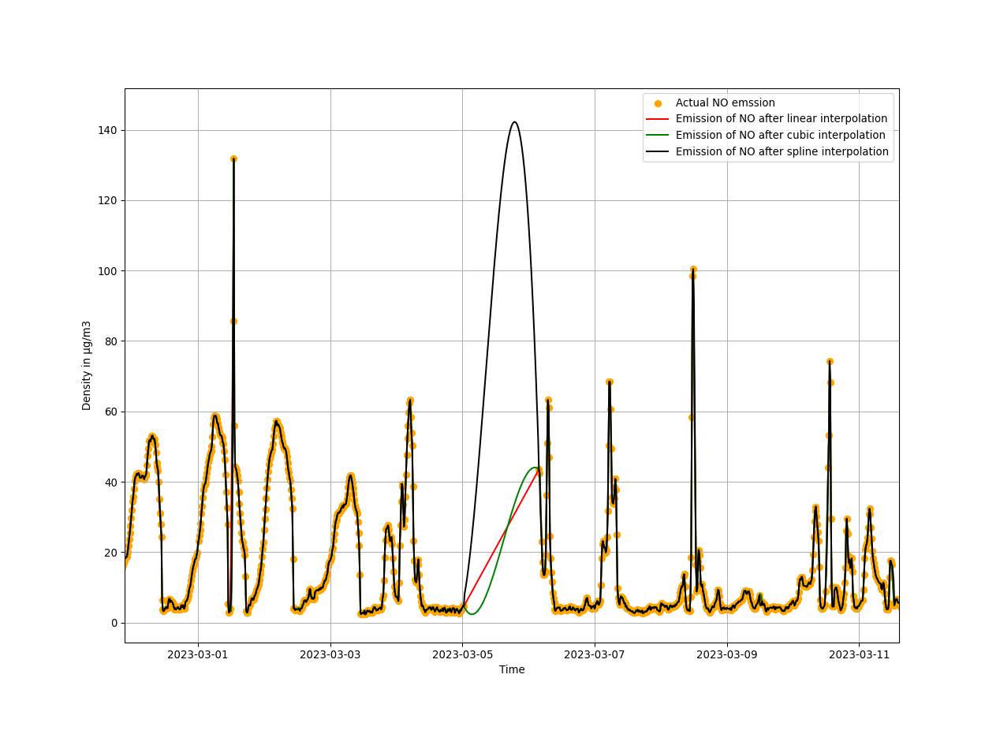

In [106]:
%matplotlib notebook
plt.scatter(df.index, NO, label='Actual NO emssion', color='orange')
plt.plot(df.index, df_linear['NO(µg/m3)'], label = 'Emission of NO after linear interpolation', color = 'red')
plt.plot(df.index, df_cubic['NO(µg/m3)'], label = 'Emission of NO after cubic interpolation', color = 'green')
plt.plot(df.index, df_spline['NO(µg/m3)'], label = 'Emission of NO after spline interpolation', color = 'black')
plt.xlabel('Time')
plt.ylabel('Density in µg/m3')
plt.grid()
plt.legend()
plt.show()

Cubic interpolation best suits the graph because it gets merged well in the actual data and cannot be differentiated from it
whereas others are not so accurate

# Interpolation for NO2

Linear interpolation for NO2

<IPython.core.display.Javascript object>


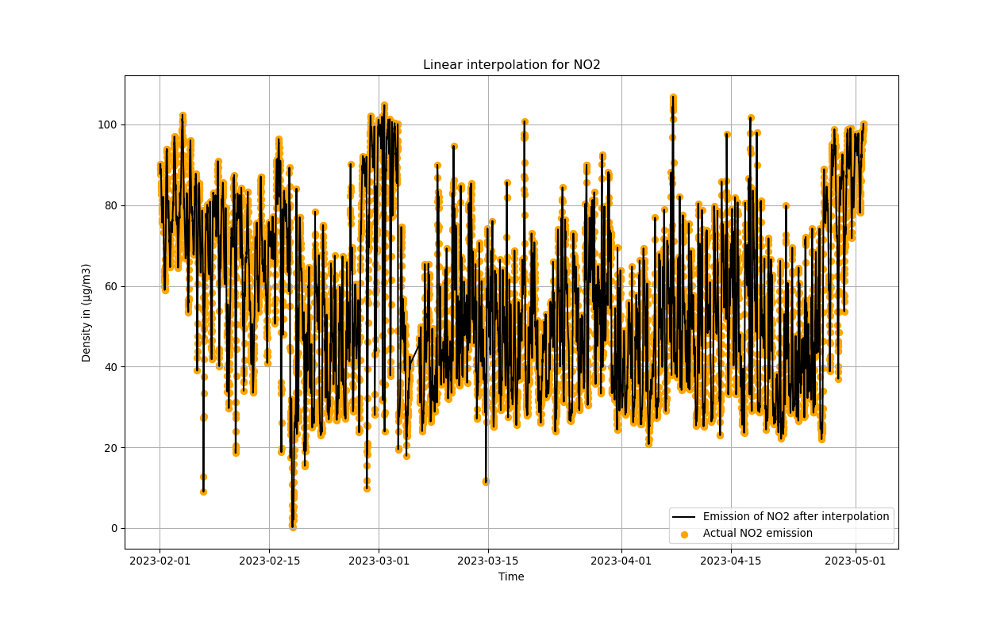

In [107]:
%matplotlib notebook
plt.plot(df.index, df_linear['NO2(µg/m3)'], label = 'Emission of NO2 after interpolation', color = 'black')
plt.scatter(df.index, NO2, label = 'Actual NO2 emission' ,  color = 'orange')
plt.title('Linear interpolation for NO2')
plt.xlabel('Time')
plt.ylabel('Density in (µg/m3)')
plt.grid()
plt.legend()
plt.show()

Cubic interpolation for NO2

<IPython.core.display.Javascript object>


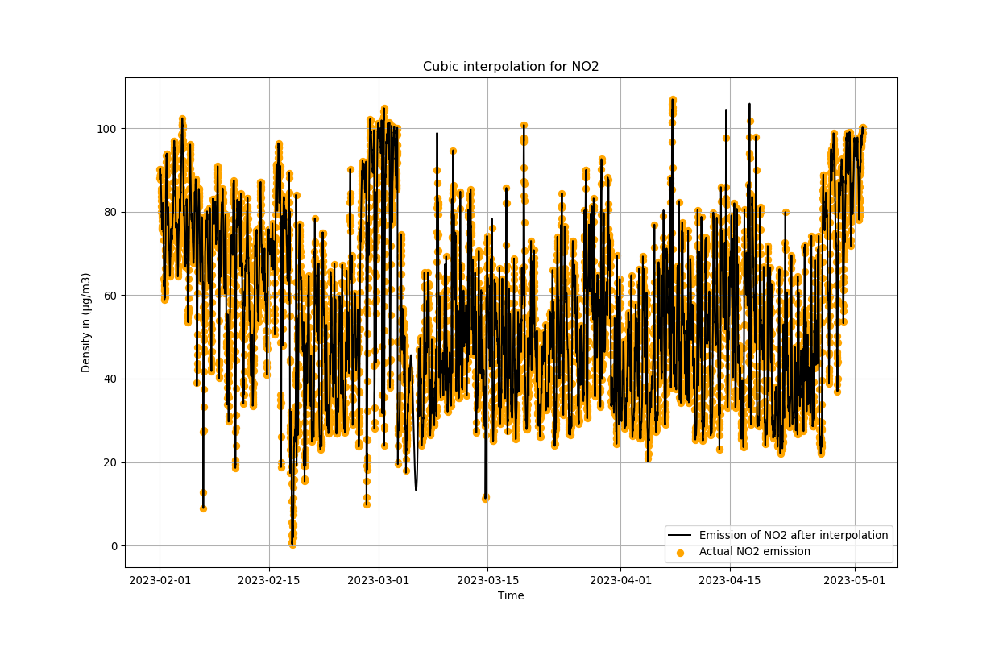

In [108]:
%matplotlib notebook
plt.plot(df.index, df_cubic['NO2(µg/m3)'], label = 'Emission of NO2 after interpolation', color = 'black')
plt.scatter(df.index, NO2, label = 'Actual NO2 emission' ,  color = 'orange')
plt.title('Cubic interpolation for NO2')
plt.xlabel('Time')
plt.ylabel('Density in (µg/m3)')
plt.grid()
plt.legend()
plt.show()

Spline interpolation for NO2

<IPython.core.display.Javascript object>


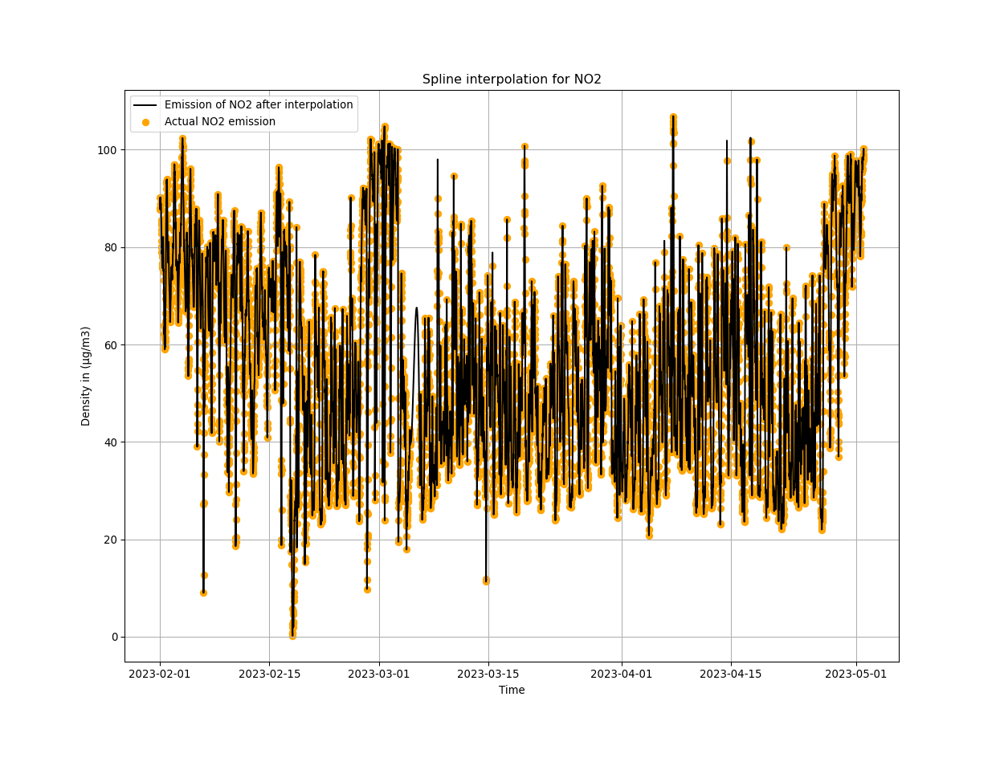

In [109]:
%matplotlib notebook
plt.plot(df.index, df_spline['NO2(µg/m3)'], label = 'Emission of NO2 after interpolation', color = 'black')
plt.scatter(df.index, NO2, label = 'Actual NO2 emission' ,  color = 'orange')
plt.title('Spline interpolation for NO2')
plt.xlabel('Time')
plt.ylabel('Density in (µg/m3)')
plt.grid()
plt.legend()
plt.show()

Comparing linear, cubic and spline interpolation together with actual data

<IPython.core.display.Javascript object>


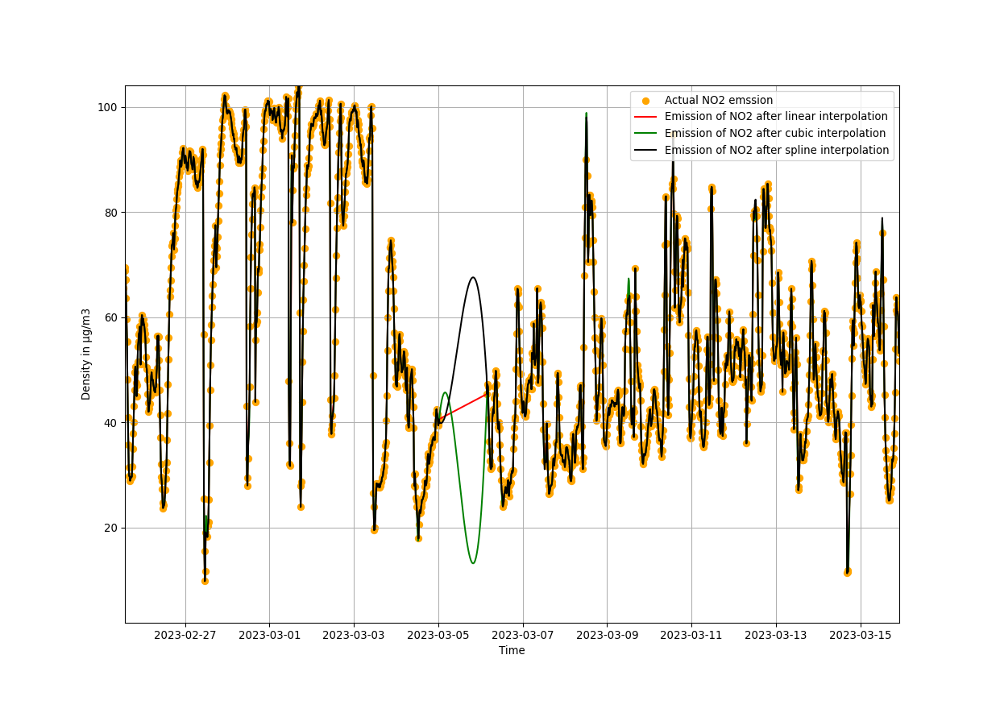

In [110]:
%matplotlib notebook
plt.scatter(df.index, NO2, label='Actual NO2 emssion', color='orange')
plt.plot(df.index, df_linear['NO2(µg/m3)'], label = 'Emission of NO2 after linear interpolation', color = 'red')
plt.plot(df.index, df_cubic['NO2(µg/m3)'], label = 'Emission of NO2 after cubic interpolation', color = 'green')
plt.plot(df.index, df_spline['NO2(µg/m3)'], label = 'Emission of NO2 after spline interpolation', color = 'black')
plt.xlabel('Time')
plt.ylabel('Density in µg/m3')
plt.grid()
plt.legend()
plt.show()

Now comparing between cubic and spline interpolation is difficult as there is major fluctuation in the graph and it is hard to decide whether it goes up or down but considering the fact that after going up it goes down suggests that spilne interpolation is the best fit

# Interpolation for NOX

Linear interpolation for NOX

<IPython.core.display.Javascript object>


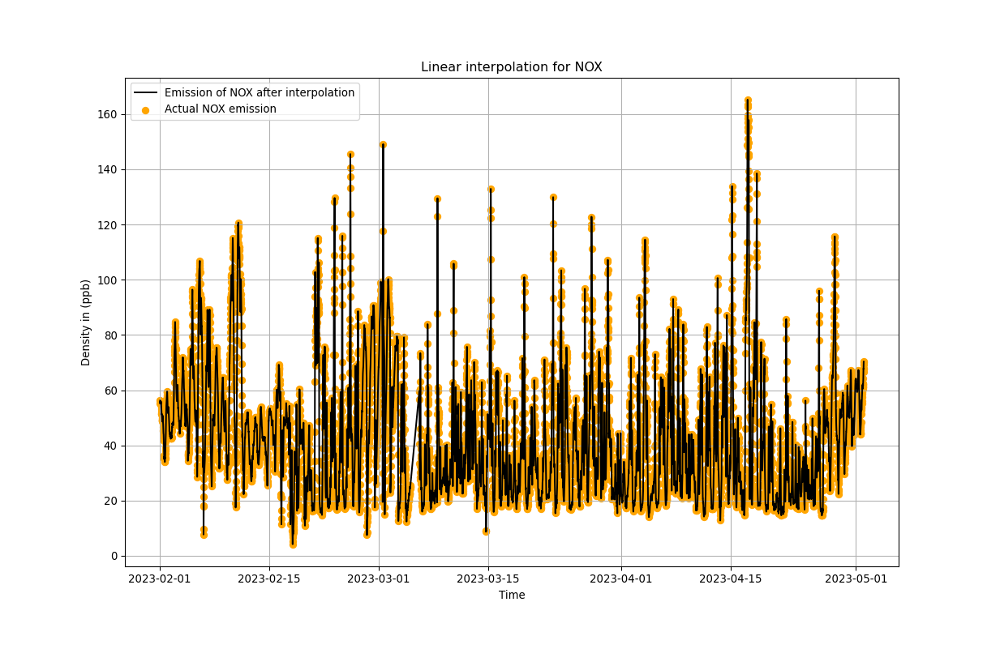

In [111]:
%matplotlib notebook
plt.plot(df.index, df_linear['NOX(ppb)'], label = 'Emission of NOX after interpolation', color = 'black')
plt.scatter(df.index, NOX, label = 'Actual NOX emission' ,  color = 'orange')
plt.title('Linear interpolation for NOX')
plt.xlabel('Time')
plt.ylabel('Density in (ppb)')
plt.grid()
plt.legend()
plt.show()

Cubic interpolation fro NOX

<IPython.core.display.Javascript object>


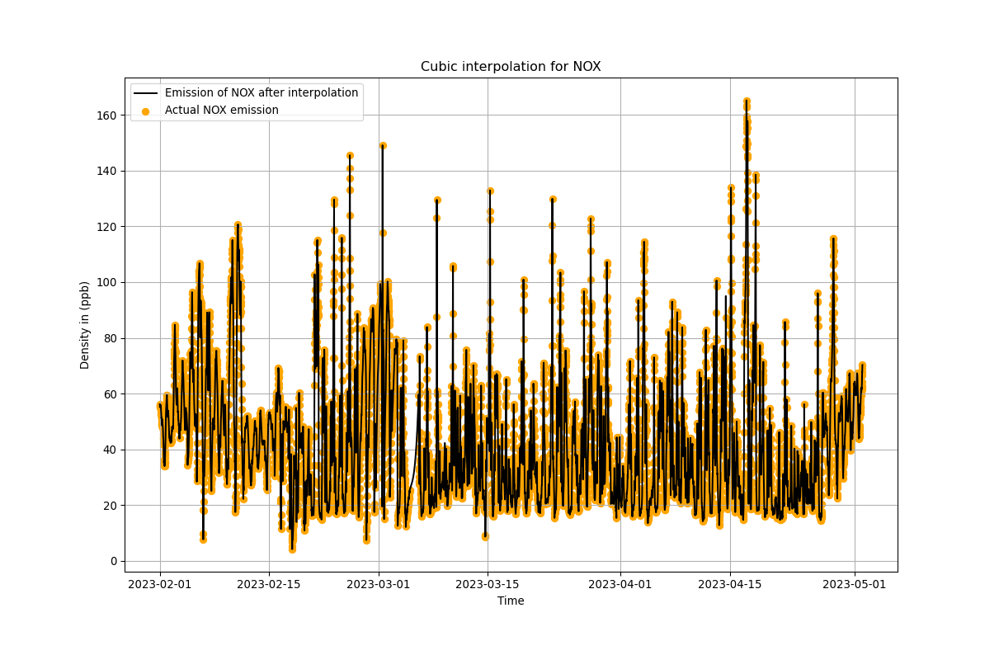

In [112]:
%matplotlib notebook
plt.plot(df.index, df_cubic['NOX(ppb)'], label = 'Emission of NOX after interpolation', color = 'black')
plt.scatter(df.index, NOX, label = 'Actual NOX emission' ,  color = 'orange')
plt.title('Cubic interpolation for NOX')
plt.xlabel('Time')
plt.ylabel('Density in (ppb)')
plt.grid()
plt.legend()
plt.show()

Spline interpolation for NOX

<IPython.core.display.Javascript object>


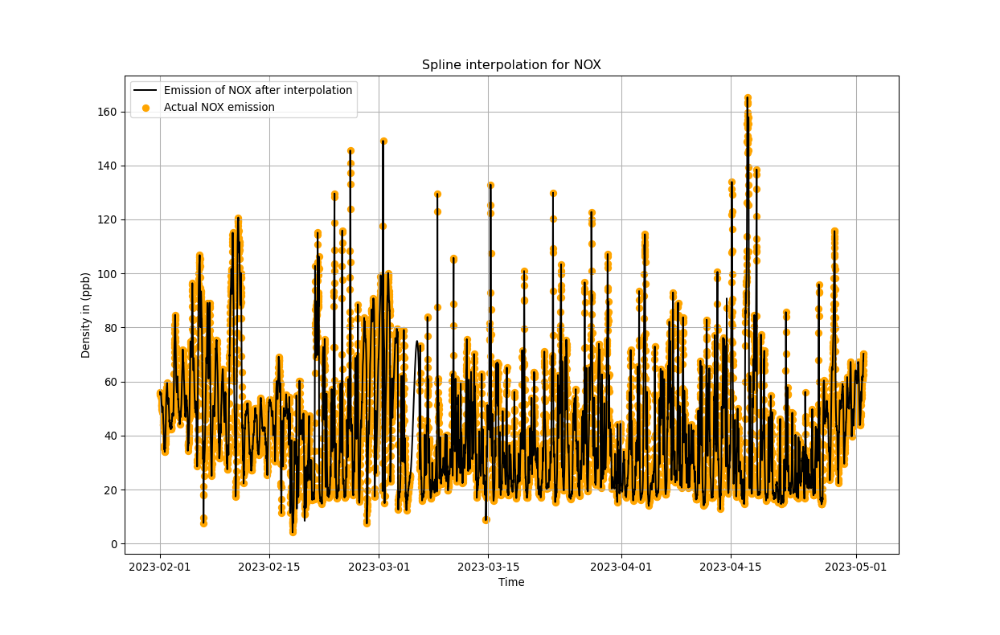

In [113]:
%matplotlib notebook
plt.plot(df.index, df_spline['NOX(ppb)'], label = 'Emission of NOX after interpolation', color = 'black')
plt.scatter(df.index, NOX, label = 'Actual NOX emission' ,  color = 'orange')
plt.title('Spline interpolation for NOX')
plt.xlabel('Time')
plt.ylabel('Density in (ppb)')
plt.grid()
plt.legend()
plt.show()

Comparing linear, cubic and spline interpolation together with actual data

<IPython.core.display.Javascript object>


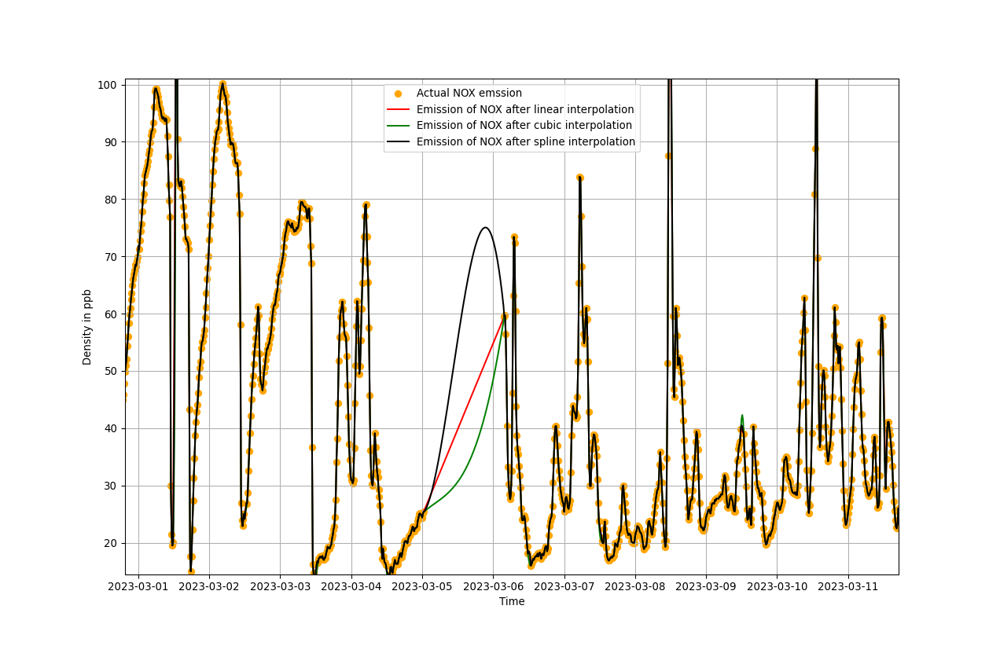

In [114]:
%matplotlib notebook
plt.scatter(df.index, NOX, label='Actual NOX emssion', color='orange')
plt.plot(df.index, df_linear['NOX(ppb)'], label = 'Emission of NOX after linear interpolation', color = 'red')
plt.plot(df.index, df_cubic['NOX(ppb)'], label = 'Emission of NOX after cubic interpolation', color = 'green')
plt.plot(df.index, df_spline['NOX(ppb)'], label = 'Emission of NOX after spline interpolation', color = 'black')
plt.xlabel('Time')
plt.ylabel('Density in ppb')
plt.grid()
plt.legend()
plt.show()

Spline interpolation gives the best fit for NOX

# Interpolation for CO

Linear interpolation for CO

<IPython.core.display.Javascript object>


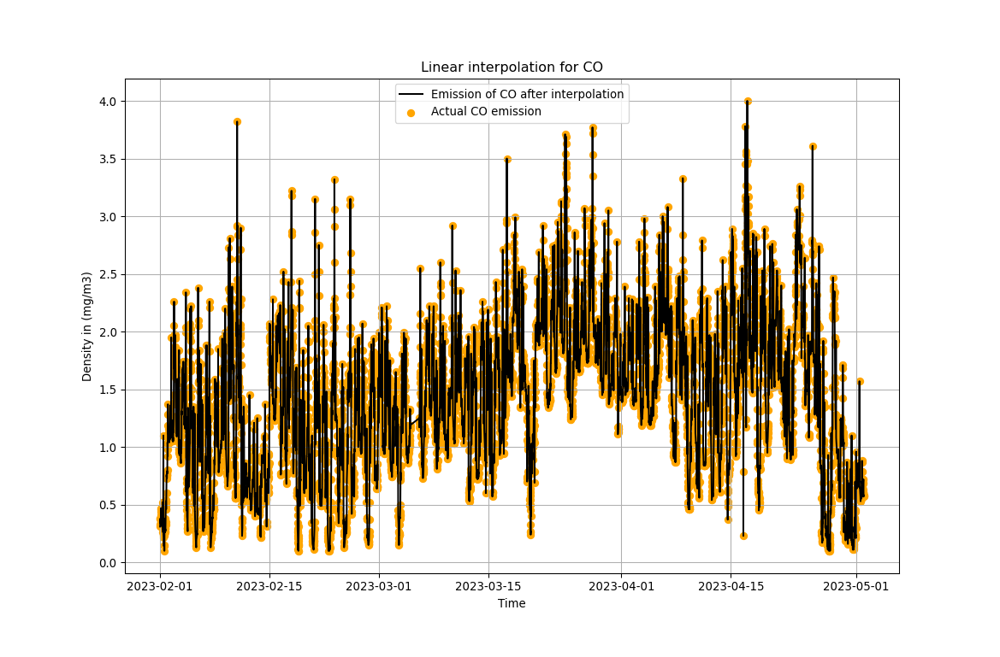

In [73]:
%matplotlib notebook
plt.plot(df.index, df_linear['CO(mg/m3)'], label = 'Emission of CO after interpolation', color = 'black')
plt.scatter(df.index, CO, label = 'Actual CO emission' ,  color = 'orange')
plt.title('Linear interpolation for CO')
plt.xlabel('Time')
plt.ylabel('Density in (mg/m3)')
plt.grid()
plt.legend()
plt.show()

Cubic interpolation for CO

<IPython.core.display.Javascript object>


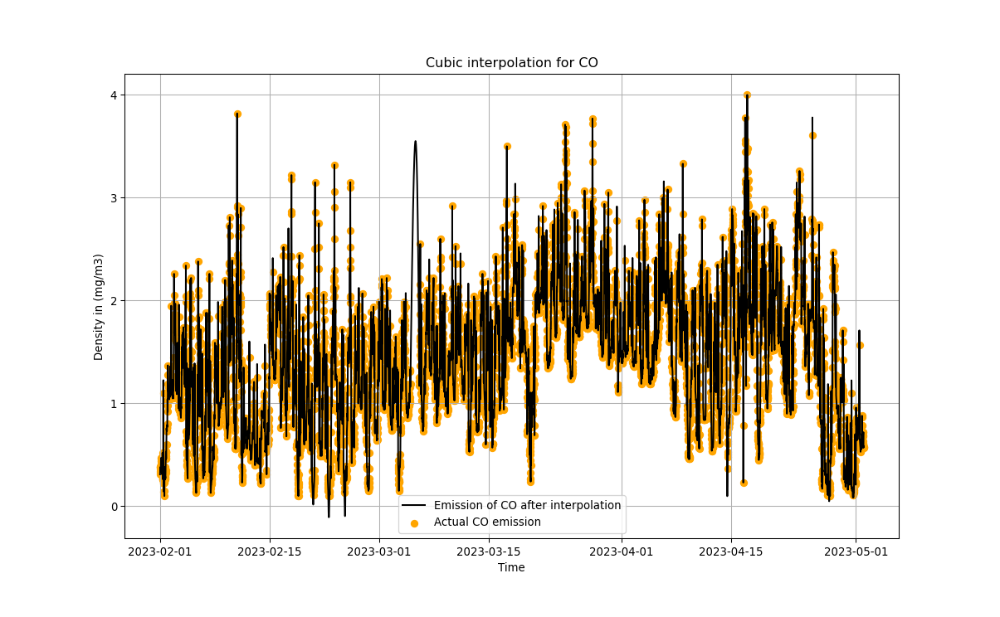

In [74]:
%matplotlib notebook
plt.plot(df.index, df_cubic['CO(mg/m3)'], label = 'Emission of CO after interpolation', color = 'black')
plt.scatter(df.index, CO, label = 'Actual CO emission' ,  color = 'orange')
plt.title('Cubic interpolation for CO')
plt.xlabel('Time')
plt.ylabel('Density in (mg/m3)')
plt.grid()
plt.legend()
plt.show()

Spline interpolation for CO

<IPython.core.display.Javascript object>


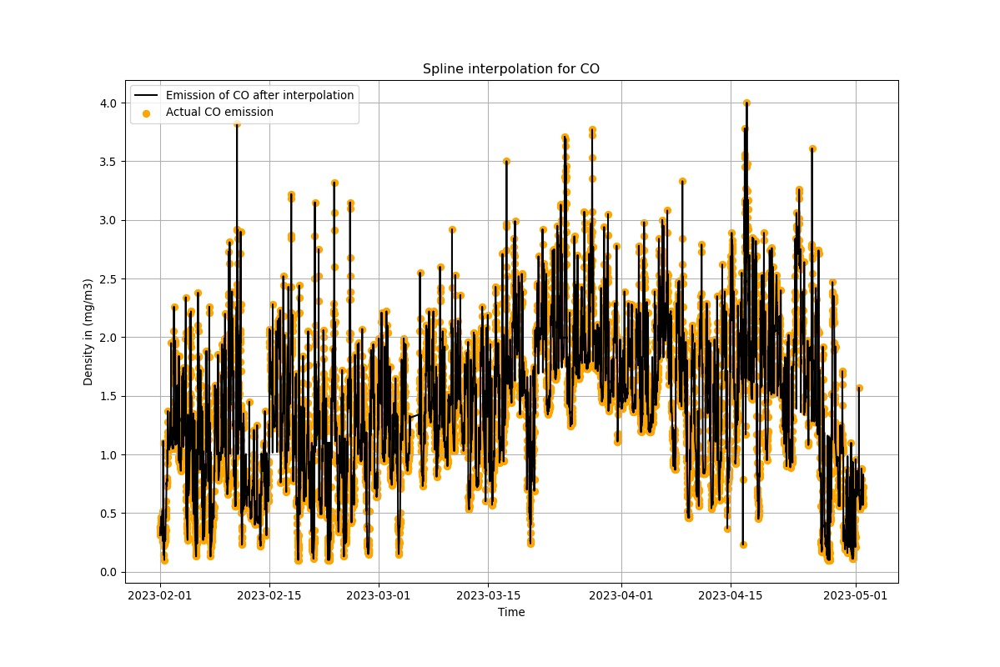

In [75]:
%matplotlib notebook
plt.plot(df.index, df_spline['CO(mg/m3)'], label = 'Emission of CO after interpolation', color = 'black')
plt.scatter(df.index, CO, label = 'Actual CO emission' ,  color = 'orange')
plt.title('Spline interpolation for CO')
plt.xlabel('Time')
plt.ylabel('Density in (mg/m3)')
plt.grid()
plt.legend()
plt.show()

Comparing linear, cubic and spline interpolation together with actual data

<IPython.core.display.Javascript object>


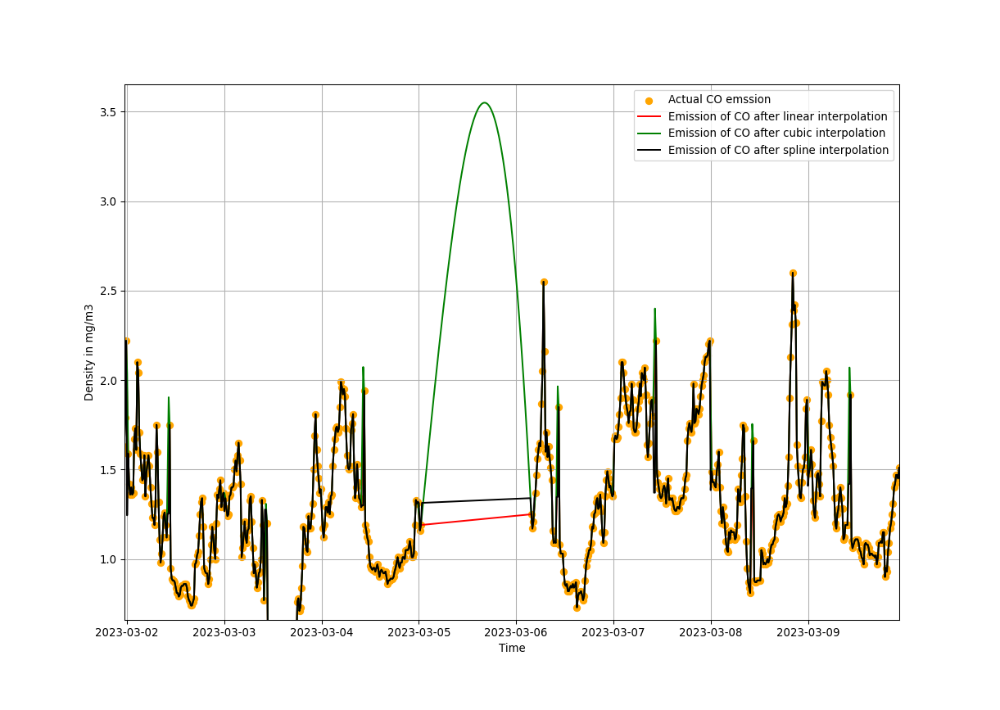

In [76]:
%matplotlib notebook
plt.scatter(df.index, CO, label='Actual CO emssion', color='orange')
plt.plot(df.index, df_linear['CO(mg/m3)'], label = 'Emission of CO after linear interpolation', color = 'red')
plt.plot(df.index, df_cubic['CO(mg/m3)'], label = 'Emission of CO after cubic interpolation', color = 'green')
plt.plot(df.index, df_spline['CO(mg/m3)'], label = 'Emission of CO after spline interpolation', color = 'black')
plt.xlabel('Time')
plt.ylabel('Density in mg/m3')
plt.grid()
plt.legend()
plt.show()

Comparing the above curves cubic interpolation gives the best fit among all

# Interpolation for SO2

Linear interpolation for SO2

<IPython.core.display.Javascript object>


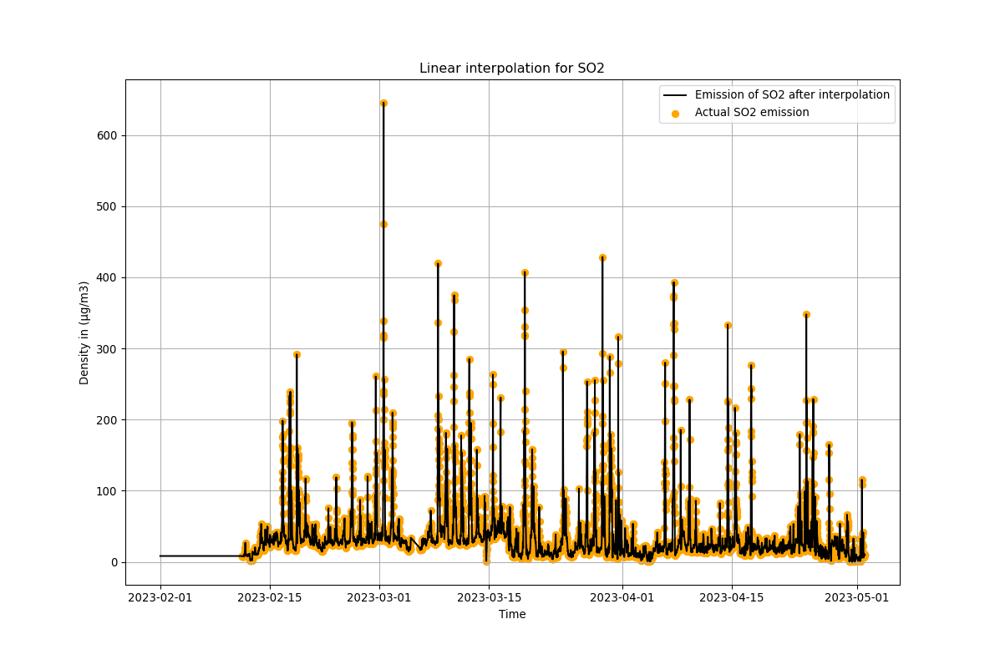

In [120]:
%matplotlib notebook
plt.plot(df.index, df_linear['SO2(µg/m3)'], label = 'Emission of SO2 after interpolation', color = 'black')
plt.scatter(df.index, SO2, label = 'Actual SO2 emission' ,  color = 'orange')
plt.title('Linear interpolation for SO2')
plt.xlabel('Time')
plt.ylabel('Density in (µg/m3)')
plt.grid()
plt.legend()
plt.show()

Cubic interpolation for SO2

<IPython.core.display.Javascript object>


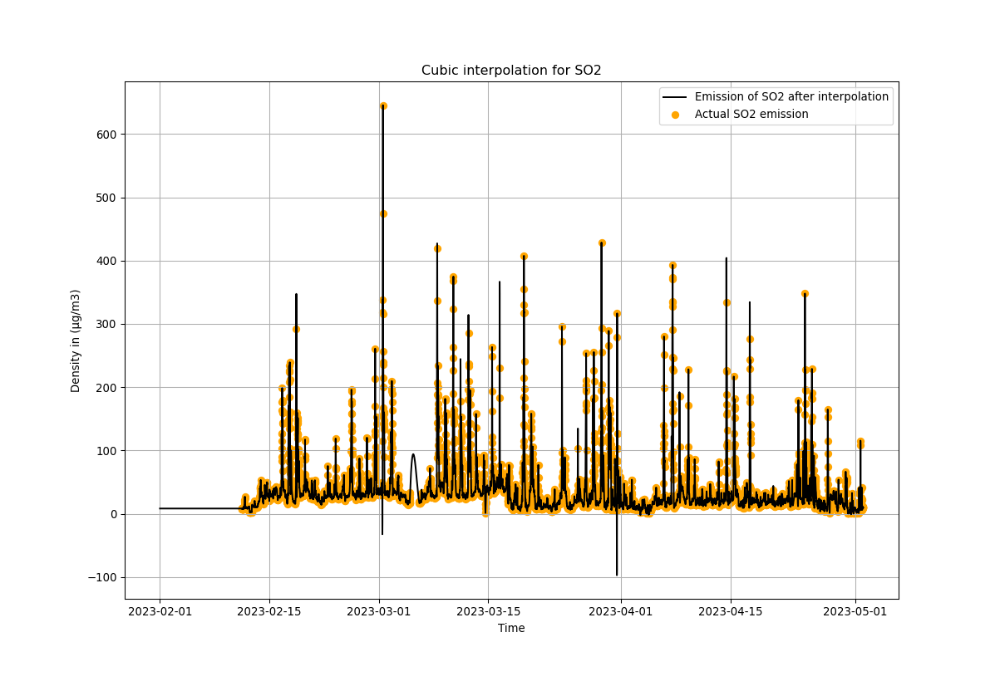

In [122]:
%matplotlib notebook
plt.plot(df.index, df_cubic['SO2(µg/m3)'], label = 'Emission of SO2 after interpolation', color = 'black')
plt.scatter(df.index, SO2, label = 'Actual SO2 emission' ,  color = 'orange')
plt.title('Cubic interpolation for SO2')
plt.xlabel('Time')
plt.ylabel('Density in (µg/m3)')
plt.grid()
plt.legend()
plt.show()

Spline interpolation for SO2

<IPython.core.display.Javascript object>


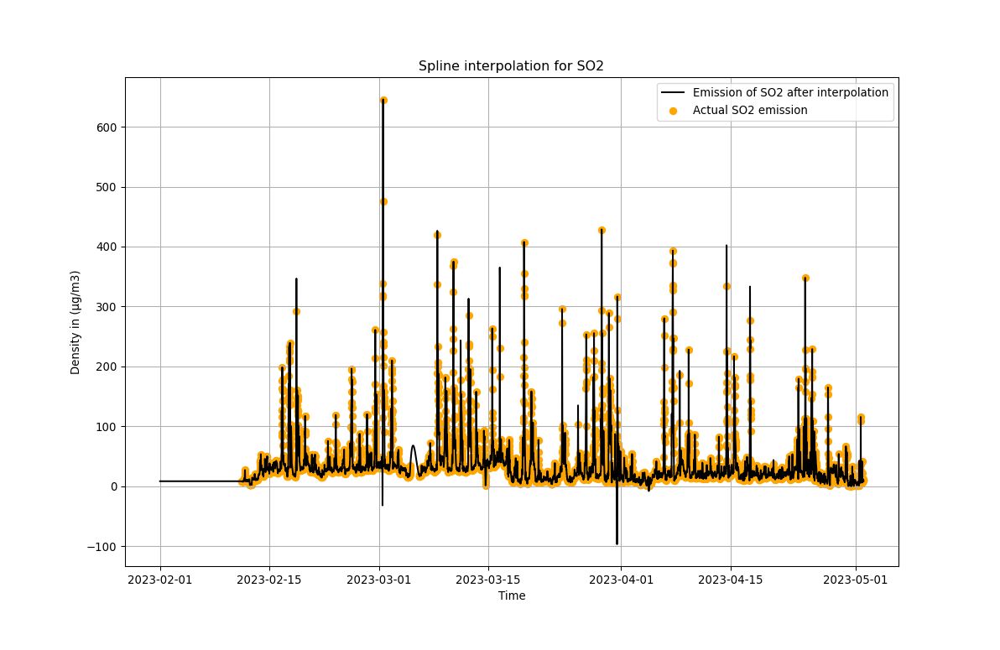

In [123]:
%matplotlib notebook
plt.plot(df.index, df_spline['SO2(µg/m3)'], label = 'Emission of SO2 after interpolation', color = 'black')
plt.scatter(df.index, SO2, label = 'Actual SO2 emission' ,  color = 'orange')
plt.title('Spline interpolation for SO2')
plt.xlabel('Time')
plt.ylabel('Density in (µg/m3)')
plt.grid()
plt.legend()
plt.show()

Comparing linear, cubic and spline interpolation together with actual data

<IPython.core.display.Javascript object>


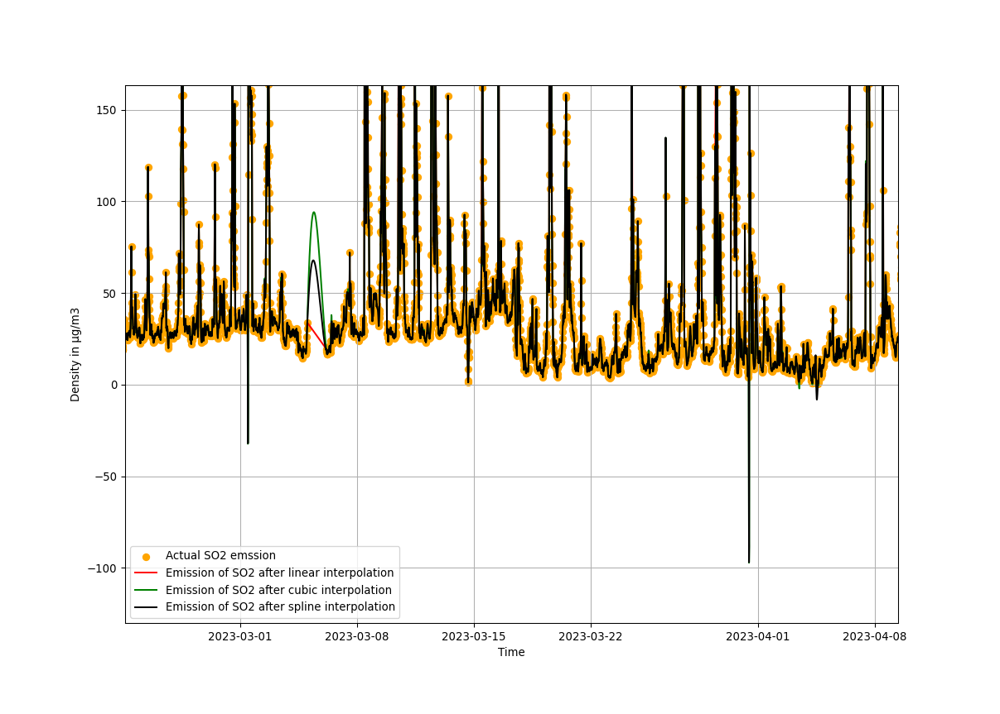

In [124]:
%matplotlib notebook
plt.scatter(df.index, SO2, label='Actual SO2 emssion', color='orange')
plt.plot(df.index, df_linear['SO2(µg/m3)'], label = 'Emission of SO2 after linear interpolation', color = 'red')
plt.plot(df.index, df_cubic['SO2(µg/m3)'], label = 'Emission of SO2 after cubic interpolation', color = 'green')
plt.plot(df.index, df_spline['SO2(µg/m3)'], label = 'Emission of SO2 after spline interpolation', color = 'black')
plt.xlabel('Time')
plt.ylabel('Density in µg/m3')
plt.grid()
plt.legend()
plt.show()

Cubic and spline interpolation both gave negative value of density so linear interpolation is best for SO2

# Interpolation for NH3

Linear interpolation for NH3

<IPython.core.display.Javascript object>


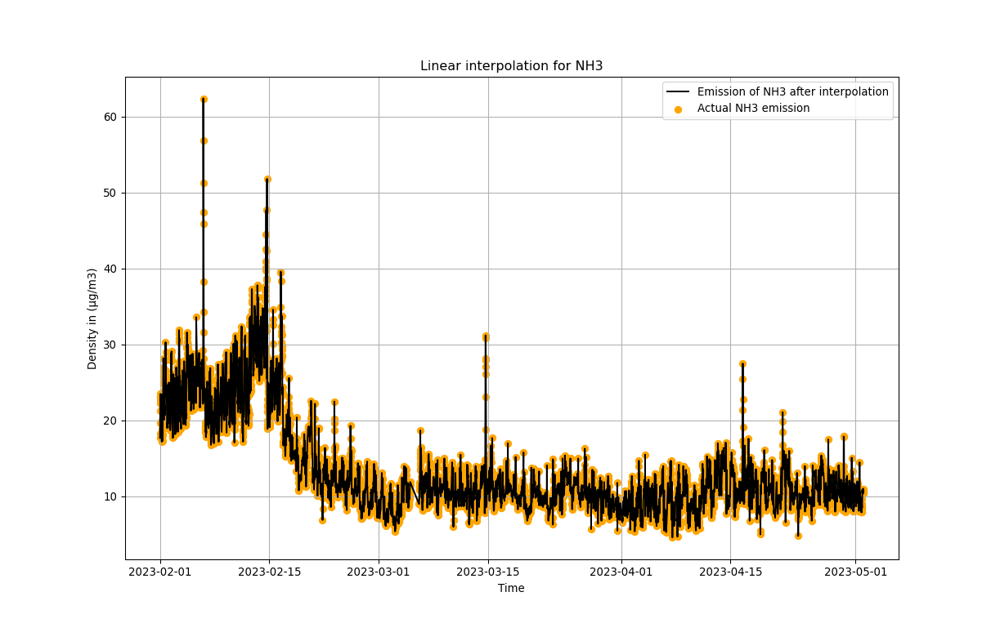

In [125]:
%matplotlib notebook
plt.plot(df.index, df_linear['NH3(µg/m3)'], label = 'Emission of NH3 after interpolation', color = 'black')
plt.scatter(df.index, NH3, label = 'Actual NH3 emission' ,  color = 'orange')
plt.title('Linear interpolation for NH3')
plt.xlabel('Time')
plt.ylabel('Density in (µg/m3)')
plt.grid()
plt.legend()
plt.show()

Cubic interpolation for NH3

<IPython.core.display.Javascript object>


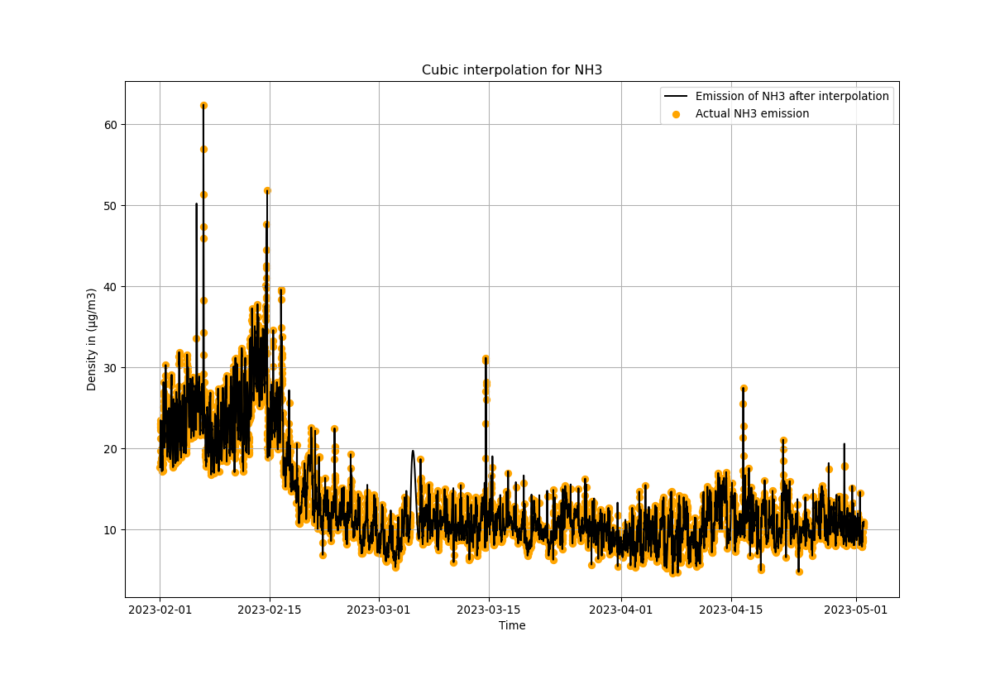

In [126]:
%matplotlib notebook
plt.plot(df.index, df_cubic['NH3(µg/m3)'], label = 'Emission of NH3 after interpolation', color = 'black')
plt.scatter(df.index, NH3, label = 'Actual NH3 emission' ,  color = 'orange')
plt.title('Cubic interpolation for NH3')
plt.xlabel('Time')
plt.ylabel('Density in (µg/m3)')
plt.grid()
plt.legend()
plt.show()

Spline interpolation for NH3

<IPython.core.display.Javascript object>


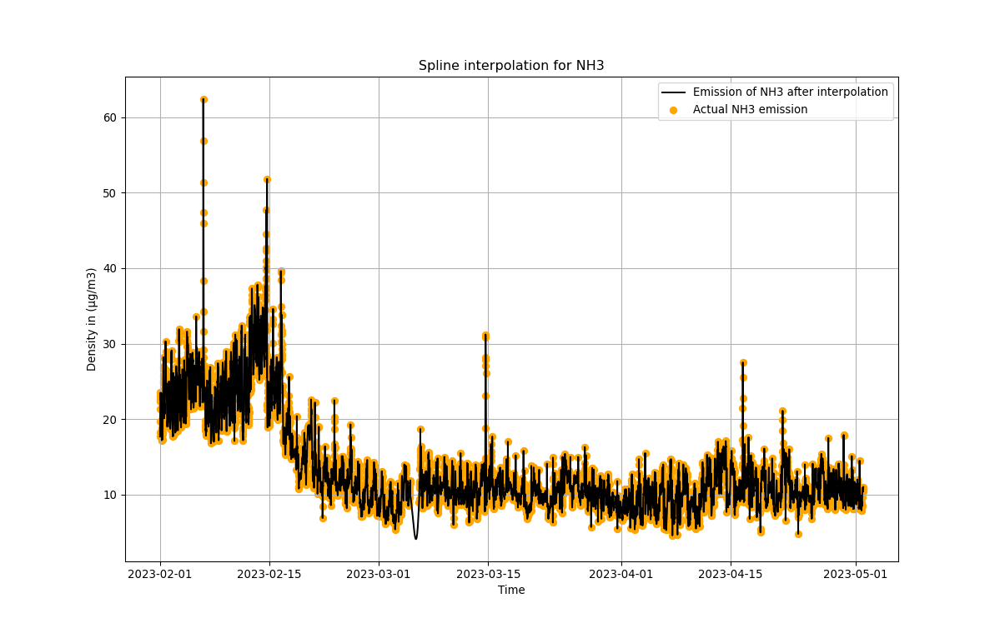

In [127]:
%matplotlib notebook
plt.plot(df.index, df_spline['NH3(µg/m3)'], label = 'Emission of NH3 after interpolation', color = 'black')
plt.scatter(df.index, NH3, label = 'Actual NH3 emission' ,  color = 'orange')
plt.title('Spline interpolation for NH3')
plt.xlabel('Time')
plt.ylabel('Density in (µg/m3)')
plt.grid()
plt.legend()
plt.show()

Comparing linear, cubic and spline interpolation together with actual data

<IPython.core.display.Javascript object>


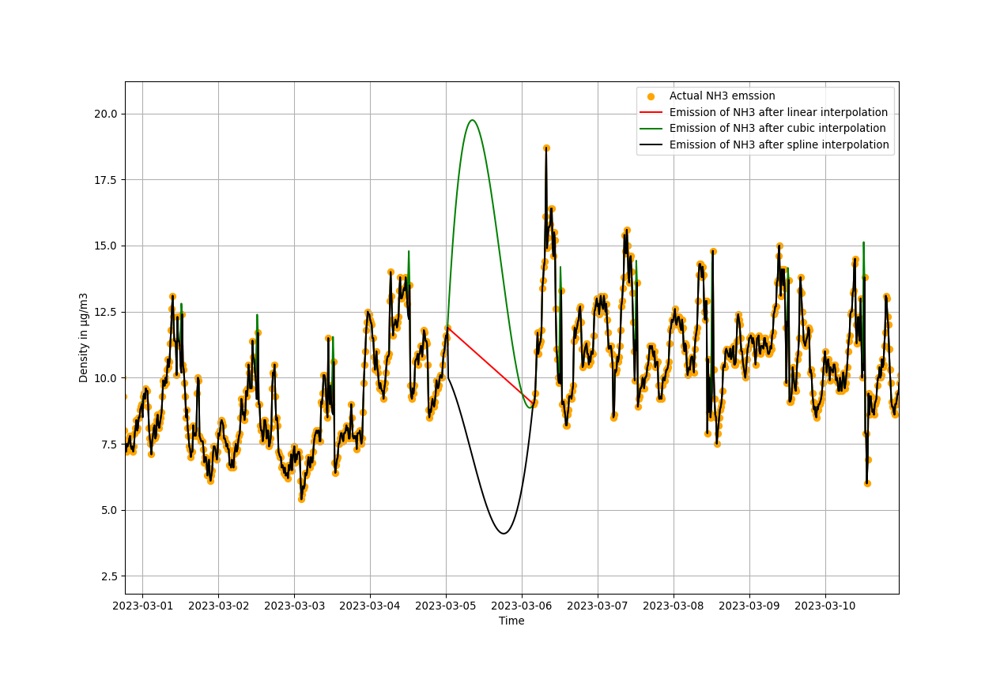

In [128]:
%matplotlib notebook
plt.scatter(df.index, NH3, label='Actual NH3 emssion', color='orange')
plt.plot(df.index, df_linear['NH3(µg/m3)'], label = 'Emission of NH3 after linear interpolation', color = 'red')
plt.plot(df.index, df_cubic['NH3(µg/m3)'], label = 'Emission of NH3 after cubic interpolation', color = 'green')
plt.plot(df.index, df_spline['NH3(µg/m3)'], label = 'Emission of NH3 after spline interpolation', color = 'black')
plt.xlabel('Time')
plt.ylabel('Density in µg/m3')
plt.grid()
plt.legend()
plt.show()

Cubic interpolation gives us the best fit as compared to linear and spline interpolation

# Interpolation for Ozone

Although we saw seasonality in the density of ozone as negligible amount is emitted in open pit mining but depleted through CFCs and UV rays so its previously interpolated data will be considered best

Linear interpolation for Ozone

<IPython.core.display.Javascript object>


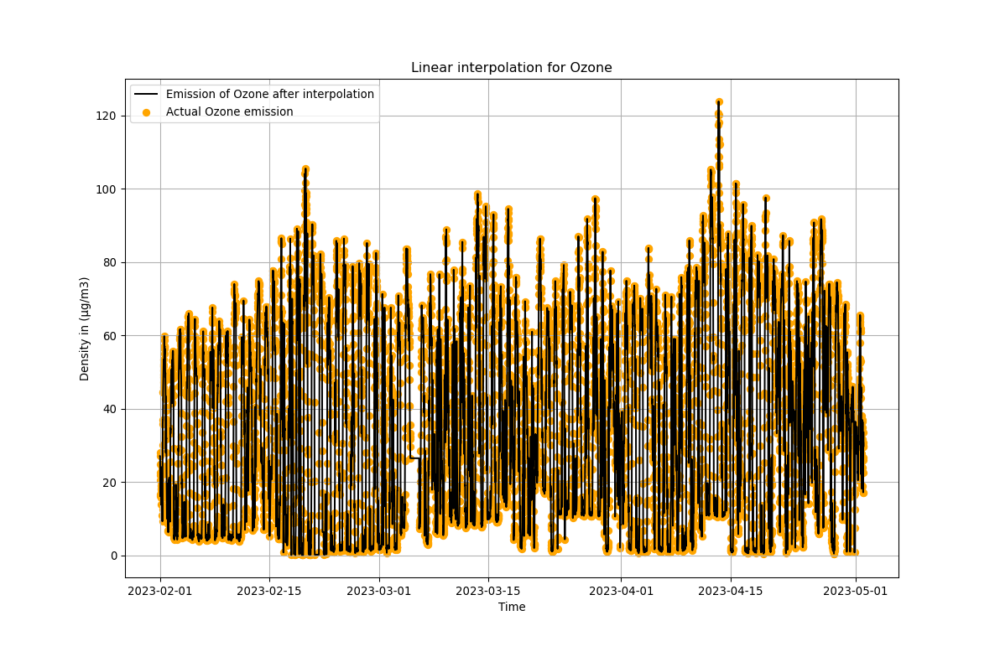

In [129]:
%matplotlib notebook
plt.plot(df.index, df_linear['Ozone(µg/m3)'], label = 'Emission of Ozone after interpolation', color = 'black')
plt.scatter(df.index, OZONE, label = 'Actual Ozone emission' ,  color = 'orange')
plt.title('Linear interpolation for Ozone')
plt.xlabel('Time')
plt.ylabel('Density in (µg/m3)')
plt.grid()
plt.legend()
plt.show()

Cubic interpolation for Ozone

<IPython.core.display.Javascript object>


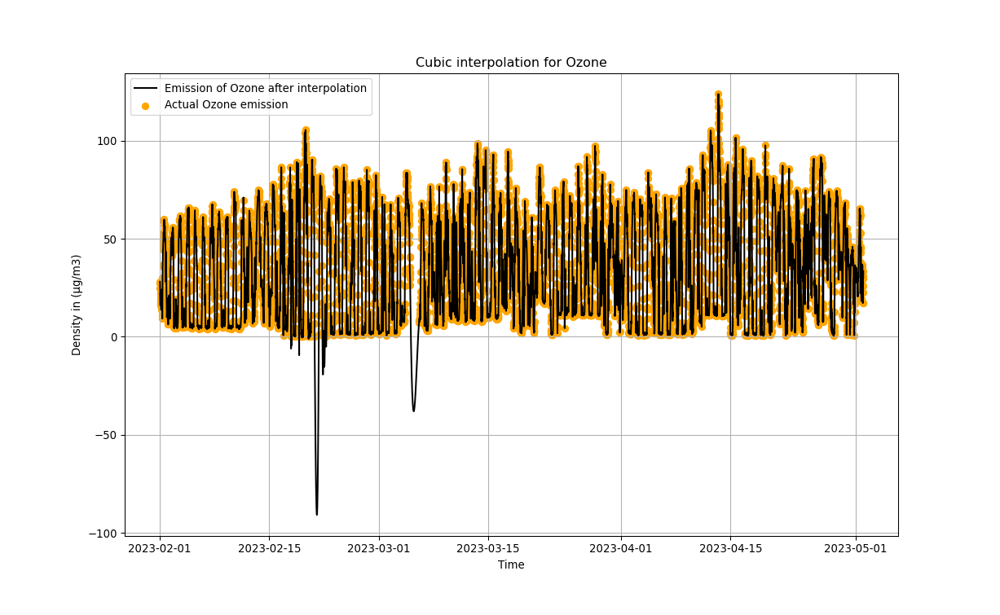

In [54]:
%matplotlib notebook
plt.plot(df.index, df_cubic['Ozone(µg/m3)'], label = 'Emission of Ozone after interpolation', color = 'black')
plt.scatter(df.index, OZONE, label = 'Actual Ozone emission' ,  color = 'orange')
plt.title('Cubic interpolation for Ozone')
plt.xlabel('Time')
plt.ylabel('Density in (µg/m3)')
plt.grid()
plt.legend()
plt.show()

Spline interpolation for Ozone

<IPython.core.display.Javascript object>


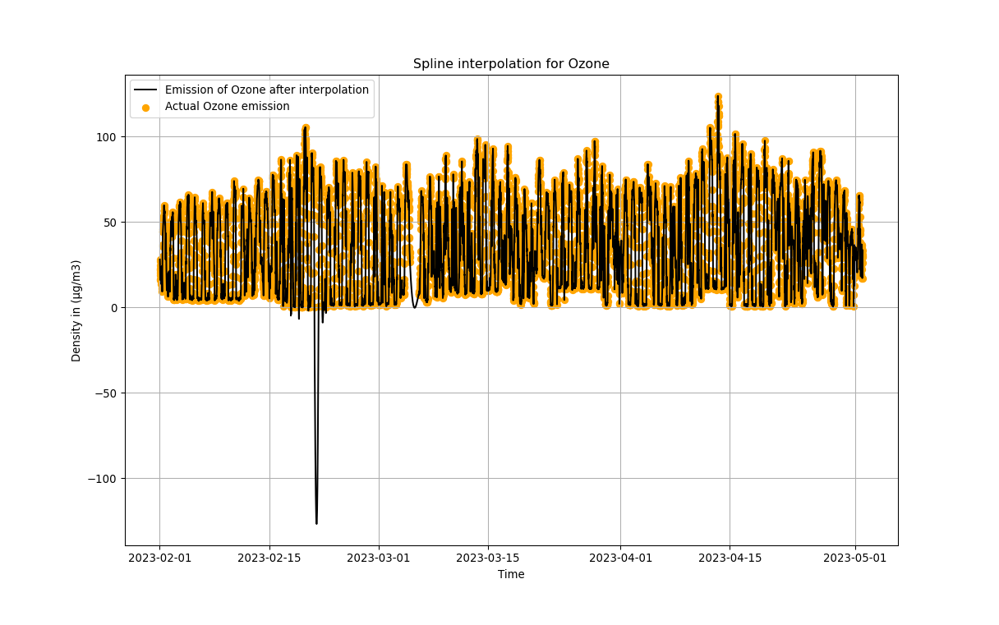

In [55]:
%matplotlib notebook
plt.plot(df.index, df_spline['Ozone(µg/m3)'], label = 'Emission of Ozone after interpolation', color = 'black')
plt.scatter(df.index, OZONE, label = 'Actual Ozone emission' ,  color = 'orange')
plt.title('Spline interpolation for Ozone')
plt.xlabel('Time')
plt.ylabel('Density in (µg/m3)')
plt.grid()
plt.legend()
plt.show()

Comparing linear, cubic and spline interpolation together with actual data

<IPython.core.display.Javascript object>


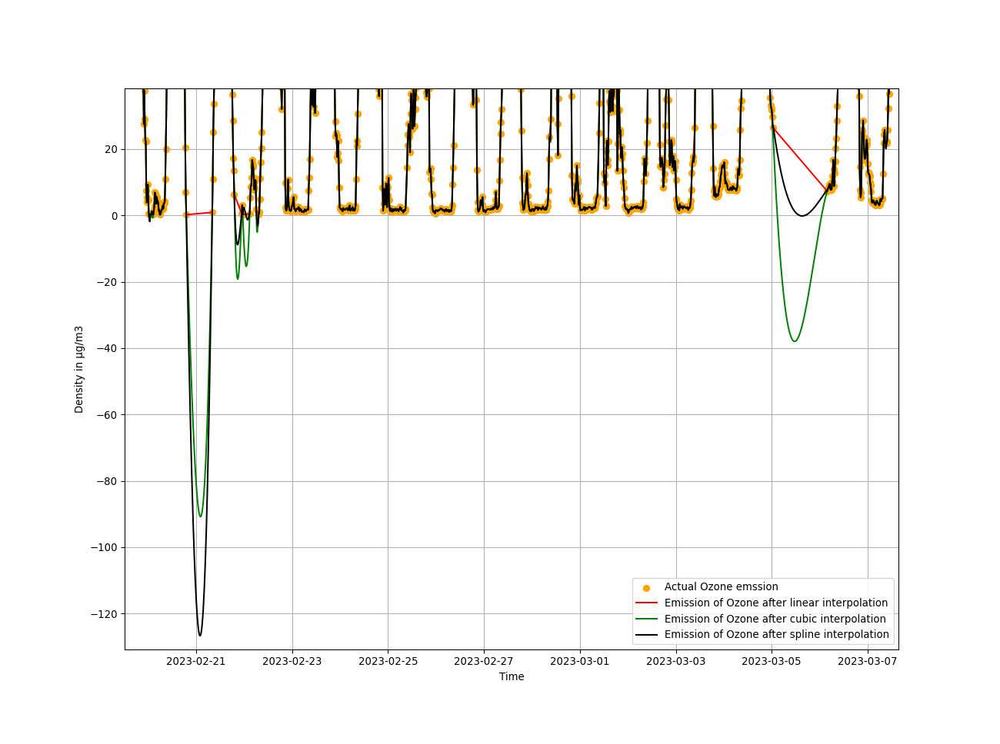

In [56]:
%matplotlib notebook
plt.scatter(df.index, OZONE, label='Actual Ozone emssion', color='orange')
plt.plot(df.index, df_linear['Ozone(µg/m3)'], label = 'Emission of Ozone after linear interpolation', color = 'red')
plt.plot(df.index, df_cubic['Ozone(µg/m3)'], label = 'Emission of Ozone after cubic interpolation', color = 'green')
plt.plot(df.index, df_spline['Ozone(µg/m3)'], label = 'Emission of Ozone after spline interpolation', color = 'black')
plt.xlabel('Time')
plt.ylabel('Density in µg/m3')
plt.grid()
plt.legend()
plt.show()

Clearly Cubic and spline interpolation for ozone is of no use as it gives negative density of ozone so we may go for linear but as discussed above ozone is not particularly released in open pit mining but is formed due to reaction between the pollutants so it does not cause for the density of ozone to change much than it changes by other factors such as ozone layer depletion.

Hence we remain for the seasonal interpolation for ozone 

# Interpolation for Benzene

Linear interpolation for Benzene

<IPython.core.display.Javascript object>


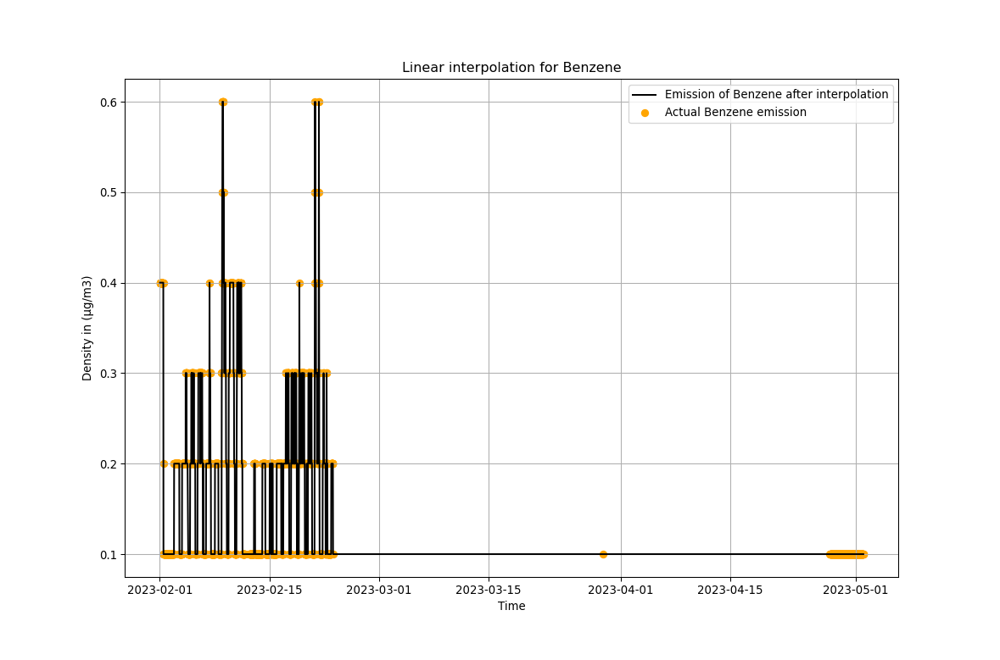

In [135]:
%matplotlib notebook
plt.plot(df.index, df_linear['Benzene(µg/m3)'], label = 'Emission of Benzene after interpolation', color = 'black')
plt.scatter(df.index, BENZENE, label = 'Actual Benzene emission' ,  color = 'orange')
plt.title('Linear interpolation for Benzene')
plt.xlabel('Time')
plt.ylabel('Density in (µg/m3)')
plt.grid()
plt.legend()
plt.show()

Now there is some visible seasonality in density of benzene, although it was not visible in acf plot of benzene because we dropped all the rows which had NaN in them. Hence insted of linear or cubic interpolating benzene we can replace its values with the previous day's same time value. It is also reasonable to do this because benzene is not emitted during open pit mining. We filled all the nan values in benzene with its previous day's same time data

Cubic interpolation for Benzene

<IPython.core.display.Javascript object>


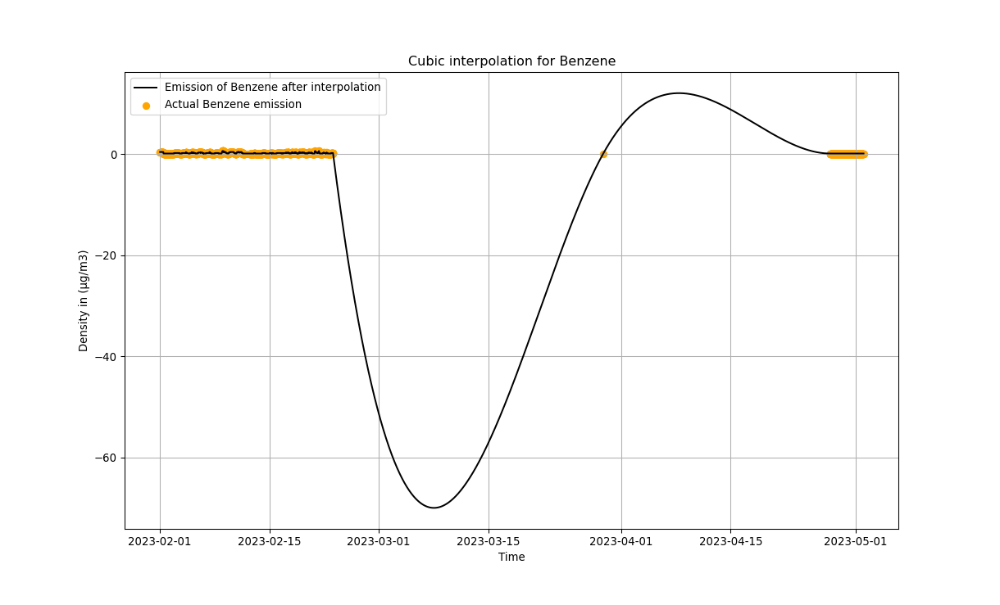

In [136]:
%matplotlib notebook
plt.plot(df.index, df_cubic['Benzene(µg/m3)'], label = 'Emission of Benzene after interpolation', color = 'black')
plt.scatter(df.index, BENZENE, label = 'Actual Benzene emission' ,  color = 'orange')
plt.title('Cubic interpolation for Benzene')
plt.xlabel('Time')
plt.ylabel('Density in (µg/m3)')
plt.grid()
plt.legend()
plt.show()

Above graph is absurd as its density goes to negative side and remains in that region for most of the time.

Spline interpolation for Benzene

<IPython.core.display.Javascript object>


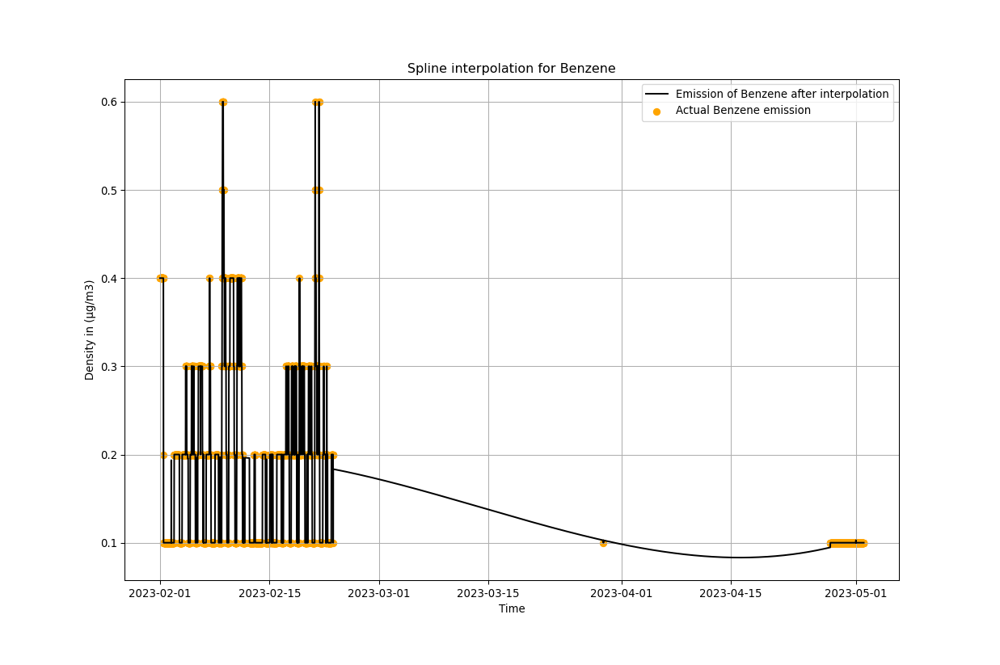

In [137]:
%matplotlib notebook
plt.plot(df.index, df_spline['Benzene(µg/m3)'], label = 'Emission of Benzene after interpolation', color = 'black')
plt.scatter(df.index, BENZENE, label = 'Actual Benzene emission' ,  color = 'orange')
plt.title('Spline interpolation for Benzene')
plt.xlabel('Time')
plt.ylabel('Density in (µg/m3)')
plt.grid()
plt.legend()
plt.show()

Comparing linear, cubic and spline interpolation together with actual data

<IPython.core.display.Javascript object>


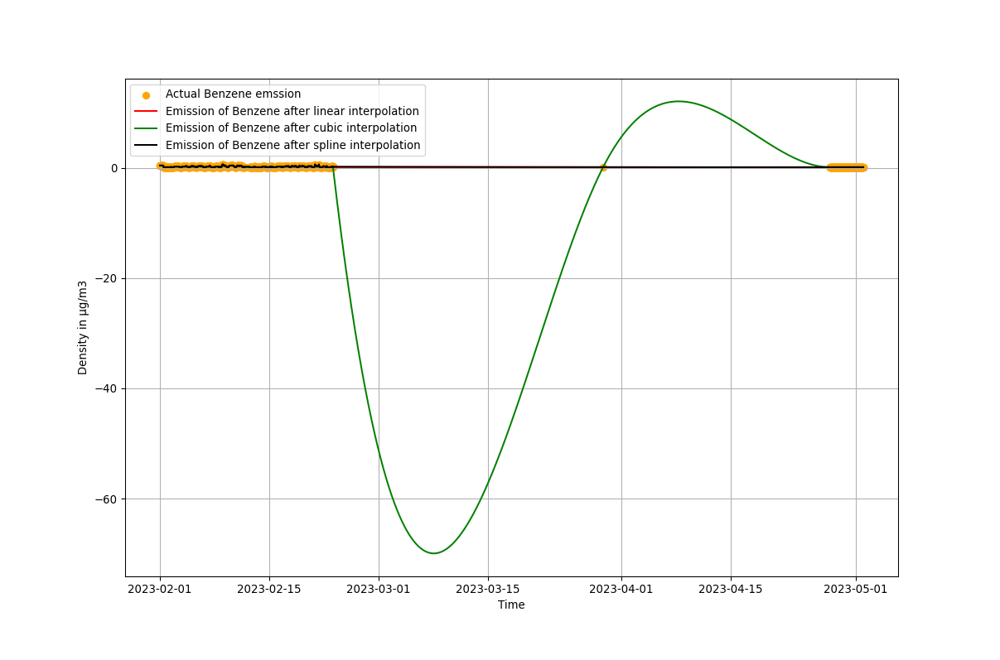

In [138]:
%matplotlib notebook
plt.scatter(df.index, BENZENE, label='Actual Benzene emssion', color='orange')
plt.plot(df.index, df_linear['Benzene(µg/m3)'], label = 'Emission of Benzene after linear interpolation', color = 'red')
plt.plot(df.index, df_cubic['Benzene(µg/m3)'], label = 'Emission of Benzene after cubic interpolation', color = 'green')
plt.plot(df.index, df_spline['Benzene(µg/m3)'], label = 'Emission of Benzene after spline interpolation', color = 'black')
plt.xlabel('Time')
plt.ylabel('Density in µg/m3')
plt.grid()
plt.legend()
plt.show()

Benzene is a volatile organic compound (VOC) that can be released into the environment from various sources, including industrial activities. While benzene is not directly associated with open pit mining, its release could potentially occur as a result of certain mining operations or associated activities.

Till now linear interpolation gives the only valid and satisfactory result but we know that benzene has seasonality in it and also benzene is released in very small amount during open pit mining. We can say that density of benzene should be affedted less by open pit mining and more by other factors which results in the seasonaity of benzene density so we go for the interpoltion through seasonality.

In [18]:
import plotly.express as px
fig = px.line(df, x=df.index, y='Benzene(µg/m3)', title='emission of Benzene in (µg/m3)')
fig.update_xaxes(
    rangeslider_visible = True,
    rangeselector = dict(
        buttons = list([
            dict(count = 1, label = "1m", step="month", stepmode="backward"),
            dict(count = 2, label = "2m", step="month", stepmode="backward"),
            dict(count = 3, label = "3m", step="month", stepmode="backward"),
            dict(step="all")
        ])))
fig.show()

Visible seasonality in Benzene

In [19]:
df_filled = df['Benzene(µg/m3)']
df_filled

To
2023-02-01 00:15:00    0.4
2023-02-01 00:30:00    0.4
2023-02-01 00:45:00    0.4
2023-02-01 01:00:00    0.4
2023-02-01 01:15:00    0.4
                      ... 
2023-05-01 23:00:00    0.1
2023-05-01 23:15:00    0.1
2023-05-01 23:30:00    0.1
2023-05-01 23:45:00    0.1
2023-05-02 00:00:00    0.1
Name: Benzene(µg/m3), Length: 8640, dtype: float64

In [20]:
df_filled = pd.DataFrame(df_filled)
df_filled

,Benzene(µg/m3)
To,
2023-02-01 00:15:00,0.4
2023-02-01 00:30:00,0.4
2023-02-01 00:45:00,0.4
2023-02-01 01:00:00,0.4
2023-02-01 01:15:00,0.4
...,...
2023-05-01 23:00:00,0.1
2023-05-01 23:15:00,0.1
2023-05-01 23:30:00,0.1


In [21]:
df_filled.reset_index(inplace = True)

In [22]:
df_filled['Benzene(µg/m3)']

0       0.4
1       0.4
2       0.4
3       0.4
4       0.4
       ... 
8635    0.1
8636    0.1
8637    0.1
8638    0.1
8639    0.1
Name: Benzene(µg/m3), Length: 8640, dtype: float64

In [23]:
df_filled.drop(['To'], axis=1, inplace=True)

In [24]:
k = 2126
while k<8640 :
    if(np.isnan(df_filled.loc[k,'Benzene(µg/m3)'])) :
        df_filled.loc[k,'Benzene(µg/m3)'] = df_filled.loc[k-1336,'Benzene(µg/m3)']
    k += 1

<IPython.core.display.Javascript object>


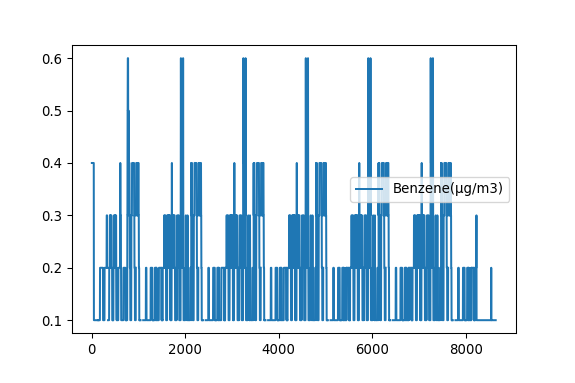

<AxesSubplot:>

In [25]:
%matplotlib notebook
df_filled.plot()

Considering the seasonality we replaced the nan values of benzene with the data given on the previous day and hour without disturbing the actual data

Forward filling the remaining nan values

In [26]:
df_filled.fillna(method='ffill')

,Benzene(µg/m3)
0,0.4
1,0.4
2,0.4
3,0.4
4,0.4
...,...
8635,0.1
8636,0.1
8637,0.1
8638,0.1


Now we plot the given benzene data with our interpolated data

In [27]:
interpolated_benzene = df_filled['Benzene(µg/m3)']

In [28]:
df_filled['time'] = df.index

In [29]:
df_filled

,Benzene(µg/m3),time
0,0.4,2023-02-01 00:15:00
1,0.4,2023-02-01 00:30:00
2,0.4,2023-02-01 00:45:00
3,0.4,2023-02-01 01:00:00
4,0.4,2023-02-01 01:15:00
...,...,...
8635,0.1,2023-05-01 23:00:00
8636,0.1,2023-05-01 23:15:00
8637,0.1,2023-05-01 23:30:00
8638,0.1,2023-05-01 23:45:00


In [30]:
df_filled.set_index(['time'], inplace = True)

In [33]:
df_filled.fillna(method='bfill')

,Benzene(µg/m3)
time,
2023-02-01 00:15:00,0.4
2023-02-01 00:30:00,0.4
2023-02-01 00:45:00,0.4
2023-02-01 01:00:00,0.4
2023-02-01 01:15:00,0.4
...,...
2023-05-01 23:00:00,0.1
2023-05-01 23:15:00,0.1
2023-05-01 23:30:00,0.1


In [34]:
df_filled.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 8640 entries, 2023-02-01 00:15:00 to 2023-05-02 00:00:00
Data columns (total 1 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Benzene(µg/m3)  8232 non-null   float64
dtypes: float64(1)
memory usage: 135.0 KB


<IPython.core.display.Javascript object>


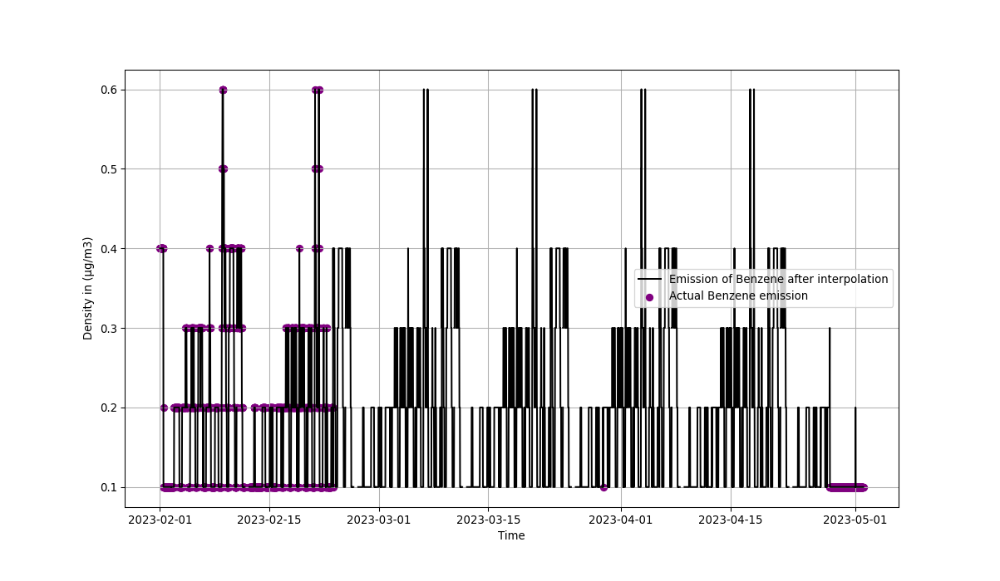

In [87]:
%matplotlib notebook
plt.plot(df.index, interpolated_benzene, label = 'Emission of Benzene after interpolation', color = 'black')
plt.scatter(df.index, BENZENE, label = 'Actual Benzene emission' ,  color = 'purple')
plt.xlabel('Time')
plt.ylabel('Density in (µg/m3)')
plt.grid()
plt.legend()
plt.show()

Above graph is the best interpolation for Benzene

# Comparing ARIMA model with Interpolation

# Comparison for NH3

In [70]:
file = r'C:\Users\nkuma\Downloads\EE 798Q\NH3_forecast.csv'
nh3_arima = pd.read_csv(file, index_col = 0 ,header = 0)

In [82]:
nh3_arima = pd.DataFrame(nh3_arima)
nh3_arima.tail()

,NH3 forecast
To,
2023-05-01 23:00:00,9.731426
2023-05-01 23:15:00,9.731426
2023-05-01 23:30:00,9.731426
2023-05-01 23:45:00,9.731426
2023-05-02 00:00:00,9.731426


<IPython.core.display.Javascript object>


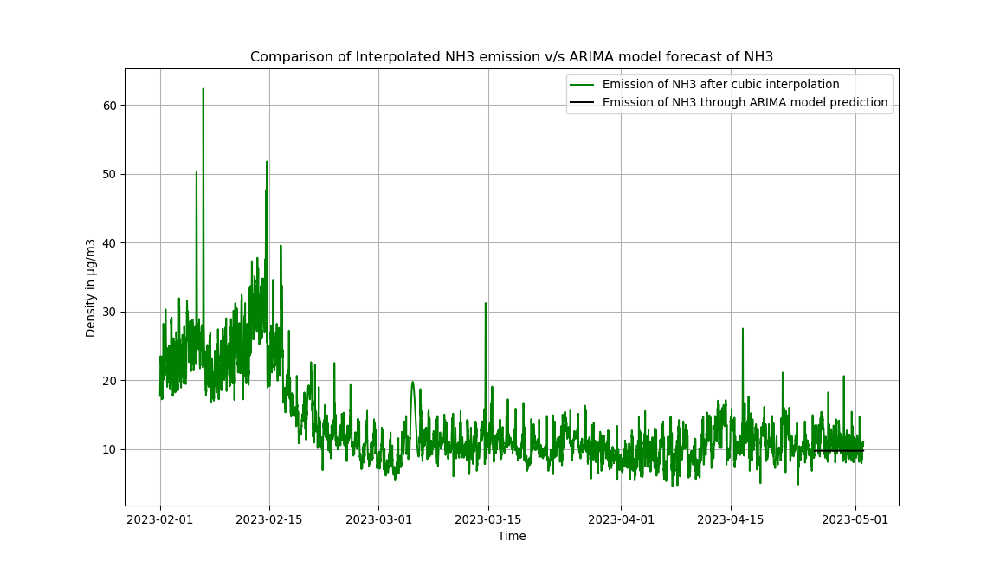

In [72]:
%matplotlib notebook
plt.plot(df.index, df_cubic['NH3(µg/m3)'], label = 'Emission of NH3 after cubic interpolation', color = 'green')
plt.plot(df.index, nh3_arima['NH3 forecast'], label = 'Emission of NH3 through ARIMA model prediction', color = 'black')
plt.xlabel('Time')
plt.ylabel('Density in µg/m3')
plt.title('Comparison of Interpolated NH3 emission v/s ARIMA model forecast of NH3')
plt.grid()
plt.legend()
plt.show()

# Comparison for Ozone

In [73]:
file = r'C:\Users\nkuma\Downloads\EE 798Q\Ozone_forecast.csv'
ozone_arima = pd.read_csv(file, index_col = 0 ,header = 0)

In [81]:
ozone_arima = pd.DataFrame(ozone_arima)
ozone_arima.tail()

,Ozone forecast
To,
2023-05-01 23:00:00,35.384746
2023-05-01 23:15:00,35.384746
2023-05-01 23:30:00,35.384746
2023-05-01 23:45:00,35.384746
2023-05-02 00:00:00,35.384746


<IPython.core.display.Javascript object>


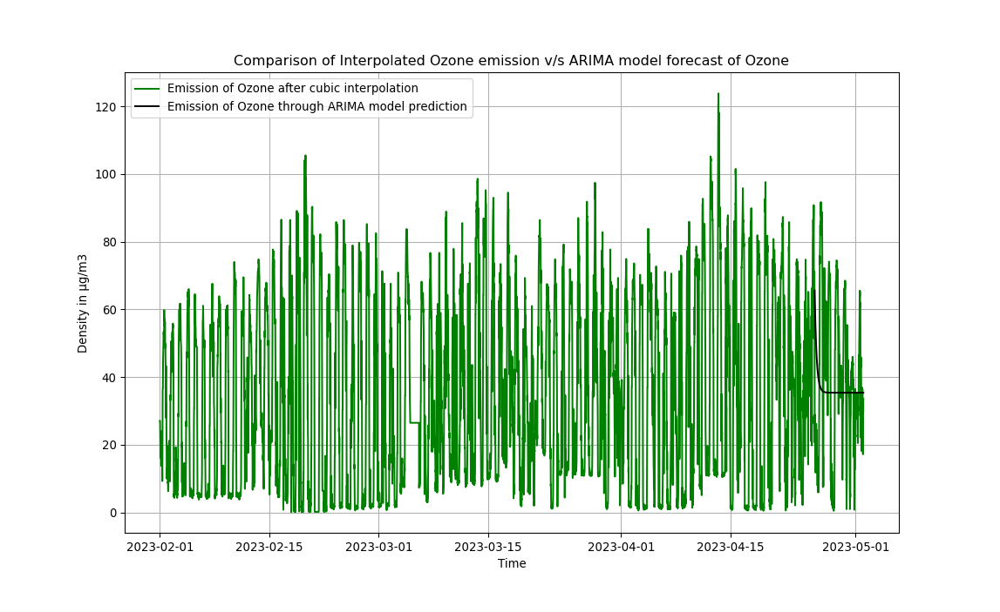

In [75]:
%matplotlib notebook
plt.plot(df.index, df_cubic['Ozone(µg/m3)'], label = 'Emission of Ozone after cubic interpolation', color = 'green')
plt.plot(df.index, ozone_arima['Ozone forecast'], label = 'Emission of Ozone through ARIMA model prediction', color = 'black')
plt.xlabel('Time')
plt.ylabel('Density in µg/m3')
plt.title('Comparison of Interpolated Ozone emission v/s ARIMA model forecast of Ozone')
plt.grid()
plt.legend()
plt.show()

# Comparison for CO

In [79]:
file = r'C:\Users\nkuma\Downloads\EE 798Q\CO_forecast.csv'
co_arima = pd.read_csv(file, index_col = 0 ,header = 0)

In [ ]:
co_arima = pd.DataFrame(co_arima)
co_arima.tail()

<IPython.core.display.Javascript object>


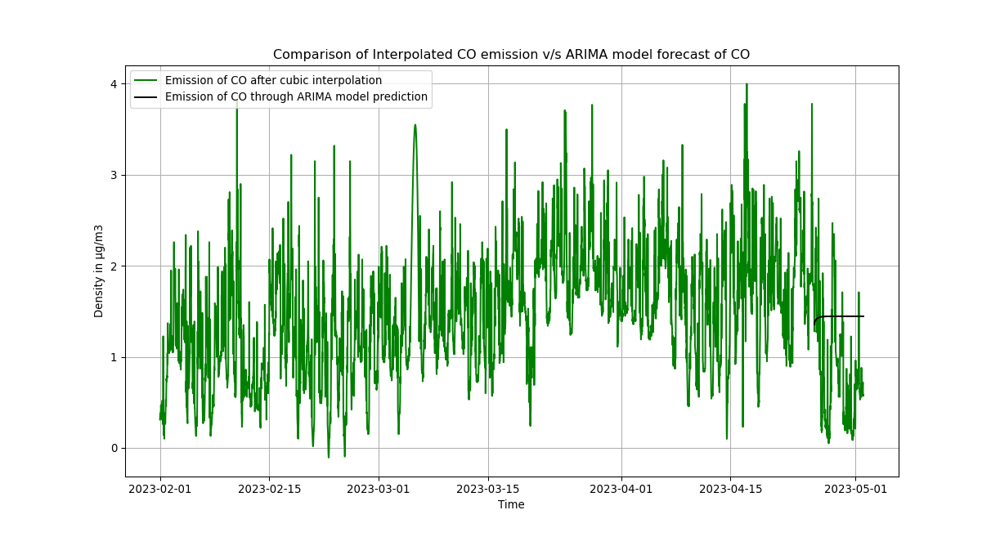

In [83]:
%matplotlib notebook
plt.plot(df.index, df_cubic['CO(µg/m3)'], label = 'Emission of CO after cubic interpolation', color = 'green')
plt.plot(df.index, co_arima['CO forecast'], label = 'Emission of CO through ARIMA model prediction', color = 'black')
plt.xlabel('Time')
plt.ylabel('Density in µg/m3')
plt.title('Comparison of Interpolated CO emission v/s ARIMA model forecast of CO')
plt.grid()
plt.legend()
plt.show()

# Comparison for Benzene

In [84]:
file = r'C:\Users\nkuma\Downloads\EE 798Q\Benzene_forecast.csv'
benzene_arima = pd.read_csv(file, index_col = 0 ,header = 0)

In [85]:
benzene_arima = pd.DataFrame(benzene_arima)
benzene_arima.tail()

,Benzene forecast
To,
2023-05-01 23:00:00,0.183808
2023-05-01 23:15:00,0.183808
2023-05-01 23:30:00,0.183808
2023-05-01 23:45:00,0.183808
2023-05-02 00:00:00,0.183808


<IPython.core.display.Javascript object>


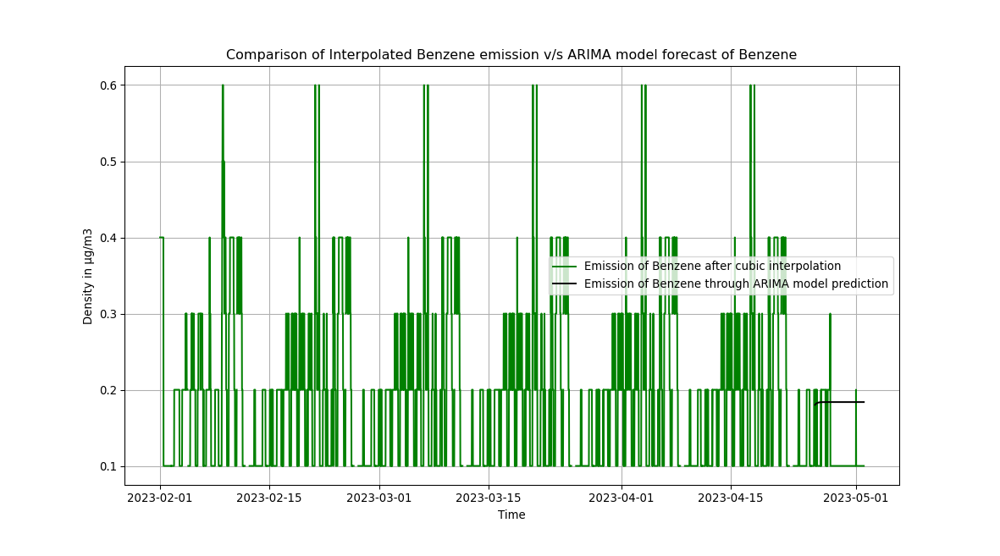

In [86]:
%matplotlib notebook
plt.plot(df.index, interpolated_benzene, label = 'Emission of Benzene after cubic interpolation', color = 'green')
plt.plot(df.index, benzene_arima['Benzene forecast'], label = 'Emission of Benzene through ARIMA model prediction', color = 'black')
plt.xlabel('Time')
plt.ylabel('Density in µg/m3')
plt.title('Comparison of Interpolated Benzene emission v/s ARIMA model forecast of Benzene')
plt.grid()
plt.legend()
plt.show()